In [1]:
import osmnx as ox
import networkx as nx
import random
import math
import pandas as pd
import matplotlib.pyplot as plt          
import numpy as np
import seaborn as sns

#### Fig-1: Comparison of growth patterns

##### Uber trips in NYC declines from March to July 2019 due to new minimum wage rule (https://www.businessinsider.com/uber-lyft-rides-decline-after-new-york-minimum-wage-2019-7?IR=T). Indeed, Uber needed to make more money to pay its drivers, so it increased the trip fares, this decreased the number of travellers and consequently the number of drivers.The next massive drop is because of Covid. 

In [2]:
# import data
nyc = pd.read_csv('data/p1-Fig1/Uber_NYC_2012-2022.csv')
nyc.date = nyc.apply(lambda row: pd.Timestamp(row.date), axis=1)
nyc.at[0,'date'] = pd.Timestamp('2012-07-01')

mi = pd.read_csv('data/p1-Fig1/Uber_Miami.csv')
mi.date = mi.apply(lambda row: pd.Timestamp(row.date), axis=1)

sea = pd.read_csv('data/p1-Fig1/Uber_Seattle.csv')
sea.date = sea.apply(lambda row: pd.Timestamp(row.date), axis=1)

ams = pd.read_csv('data/p1-Fig1/Uber_Ams_2016-2022.csv')
ams.date = ams.apply(lambda row: pd.Timestamp(row.date), axis=1)

arjan = pd.read_csv('data/p1-Fig1/Arjan_supply.csv')
arjan.date = arjan.apply(lambda row: pd.Timestamp(row.date), axis=1)

djavadian = pd.read_csv('data/p1-Fig1/Djavadian_supply.csv')
djavadian.date = djavadian.apply(lambda row: pd.Timestamp(row.date), axis=1)

ertz = pd.read_csv('data/p1-Fig1/Ertz_supply.csv')
ertz.date = ertz.apply(lambda row: pd.Timestamp(row.date), axis=1)

nyc = nyc.loc[0:88]
ertz = ertz.loc[2:29]
ams = ams[:47]

In [3]:
def smooth(y,w=41,o=1,d=5):
    from scipy.signal import savgol_filter
    nans = [float('nan') for i in range(0,d)] 
    y = nans + list(savgol_filter(y[d:],w,o))
    for i in range(0,len(y)):
        if y[i]<0:
            y[i] = 0
    return y

In [4]:
import datetime

base = pd.Timestamp('2012-07-01')
n_days = 360
step = 7.6 #7.6
# calculating timestamps for the next 10 days
timestamp_list = [base + datetime.timedelta(days=step*x) for x in range(n_days)]

df_me = pd.DataFrame()

for r in range(1,6):
    yms = pd.read_csv('data/p1-Fig1/baseline_supply{}.csv'.format(r))
    yms = yms[0:360]
    yms['date'] = timestamp_list
    yms['rep_num'] = r
    yms['ms'] = yms['OUT']/yms.OUT.max()
    yms['ms'] = smooth(yms['ms'])
    yms['ms'][0:5] = [0,0.02,0.04,0.06,0.07]
    
    df_me = pd.concat([df_me,yms[['date','rep_num', 'ms']]])

df_me

C:\Users\farno\AppData\Local\Temp/ipykernel_35744/926980430.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  yms['ms'][0:5] = [0,0.02,0.04,0.06,0.07]


,date,rep_num,ms
0,2012-07-01 00:00:00,1,0.000000
1,2012-07-08 14:24:00,1,0.020000
2,2012-07-16 04:48:00,1,0.040000
3,2012-07-23 19:12:00,1,0.060000
4,2012-07-31 09:36:00,1,0.070000
...,...,...,...
355,2019-11-20 00:00:00,5,0.957498
356,2019-11-27 14:24:00,5,0.961227
357,2019-12-05 04:48:00,5,0.964957
358,2019-12-12 19:12:00,5,0.968686


C:\Users\farno\AppData\Local\Temp/ipykernel_35744/3351827579.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aj_date = nyc.loc[6:].date; aj_date[6] = pd.Timestamp('2013-01-19')
C:\Users\farno\AppData\Local\Temp/ipykernel_35744/3351827579.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dj_date = nyc.loc[16:].date; dj_date[16] = pd.Timestamp('2013-11-20')


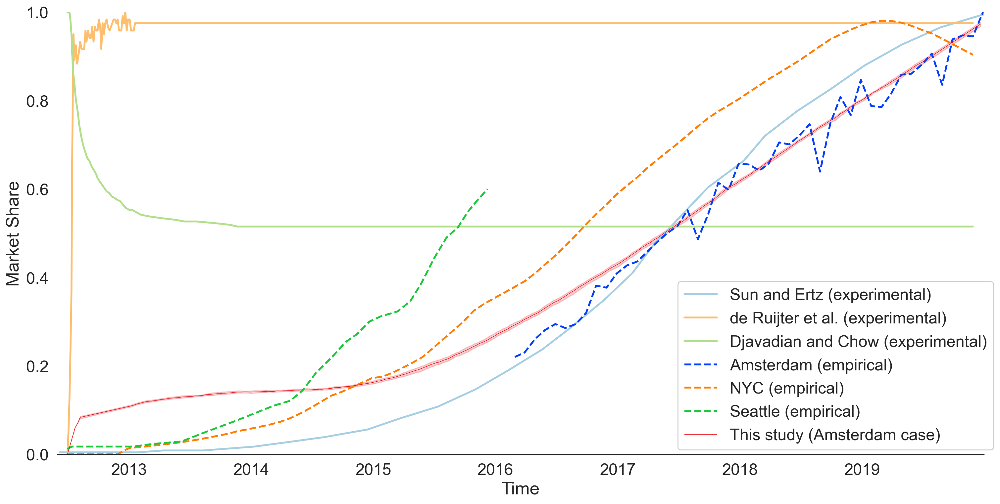

In [5]:
# Here we use min-max scaling or normalization: https://www.linkedin.com/advice/1/what-pros-cons-different-scaling-methods-data-normalization#:~:text=Data%20normalization%20and%20scaling%20can%20be%20achieved%20through%20several%20methods,dividing%20by%20the%20maximum%20value.

sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=1, figsize=(16,8))
sns.despine(left=True)

bright = sns.color_palette("bright")
blues = sns.color_palette("Blues")
greys = sns.color_palette("Greys")
paired = sns.color_palette("Paired")
#State-of-art-----------------------------------------------------------------------
ertz_max = ertz.supply_share.max()
ertz_last_v = ertz.supply_share[len(ertz)-1]
sns.lineplot(x=ertz.loc[0:29].date, y=ertz.loc[0:29].supply_share/ertz_max,lw=2, label = 'Sun and Ertz (experimental)', color=paired[0], linestyle = 'solid')
# sns.lineplot(x=ertz.loc[30:].date, y=ertz.loc[30:].supply_share/ertz_max,lw=1, color='C2', marker = '.')

arjan_max = arjan.supply_share.max()
arjan_last_v = arjan.supply_share[len(arjan)-1]
sns.lineplot(x=arjan.date, y=arjan.supply_share/arjan_max, lw=2, label = 'de Ruijter et al. (experimental)', color=paired[6], linestyle = 'solid')
aj_date = nyc.loc[6:].date; aj_date[6] = pd.Timestamp('2013-01-19')
sns.lineplot(x=aj_date, y=arjan_last_v/arjan_max, lw=2, color=paired[6], linestyle = 'solid')

djavadian_max = djavadian.supply_share.max()
djavadian_last_v = djavadian.supply_share[len(djavadian)-1]
sns.lineplot(x=djavadian.date, y=djavadian.supply_share/djavadian_max,lw=2, label = 'Djavadian and Chow (experimental)', color=paired[2], linestyle = 'solid')
dj_date = nyc.loc[16:].date; dj_date[16] = pd.Timestamp('2013-11-20')
sns.lineplot(x=dj_date, y=djavadian_last_v/djavadian_max,lw=2, color=paired[2], linestyle = 'solid')

#Empirical-----------------------------------------------------------------------
ams_max = ams['Number_of_drivers'].max()
ams_y =ams['Number_of_drivers']# smooth(ams['Number_of_drivers'], w=9)
ams_y = [0 if math.isnan(y) else y/ams_max for y in ams_y]
ams_y[0] = 0.22; ams_y[1] = 0.23
sns.lineplot(x=ams.date, y=ams_y,lw=2, label = 'Amsterdam (empirical)', color=bright[0], linestyle = 'dashed')

nyc_max = nyc['Unique Dispatched Vehicles'].max()
nyc_smoothed = smooth(nyc['Unique Dispatched Vehicles'], w=9)
nyc_y = nyc_smoothed[0:89]+list(nyc[89:97]['Unique Dispatched Vehicles'])+nyc_smoothed[97:]
nyc_y = [0 if math.isnan(y) else y/nyc_max for y in nyc_y]
# nyc_x = [x for x in range(1,len(nyc_y)+1)]
sns.lineplot(x=nyc.date, y=nyc_y,lw=2, label = 'NYC (empirical)', color=bright[1], linestyle = 'dashed')

sea_max = sea.supply_share.max()
sns.lineplot(x=sea.date, y=0.6*sea.supply_share/sea_max,lw=2, label = 'Seattle (empirical)', color=bright[2], linestyle = 'dashed')
#Us-----------------------------------------------------------------------
sns.lineplot(data=df_me, x='date', y='ms', lw=0.5, label = 'This study (Amsterdam case)', color=bright[3])

ax.set(xlabel='Time', ylabel='Market Share',xlim=(pd.Timestamp('2012-06-01 00:00:00')
,pd.Timestamp('2019-12-30 00:00:00')), ylim=(0,1))
ax.legend(frameon=True,framealpha=1, loc=(0.67,0.01))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)

plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig1.png')

In [3]:
# yms = pd.read_csv('data/dataframes/baseline_supply1.csv')
# yms = yms[0:360]

In [6]:
yms = [0.0,
 0.005,
 0.007,
 0.011,
 0.022,
 0.016,
 0.025,
 0.029,
 0.019,
 0.028,
 0.024,
 0.028,
 0.03,
 0.019,
 0.031,
 0.037,
 0.033,
 0.035,
 0.045,
 0.029,
 0.04,
 0.033,
 0.032,
 0.045,
 0.024,
 0.029,
 0.036,
 0.045,
 0.031,
 0.028,
 0.044,
 0.029,
 0.035,
 0.044,
 0.047,
 0.05,
 0.048,
 0.043,
 0.055,
 0.038,
 0.033,
 0.045,
 0.045,
 0.042,
 0.045,
 0.031,
 0.06,
 0.04,
 0.04,
 0.042,
 0.041,
 0.038,
 0.045,
 0.031,
 0.051,
 0.04,
 0.04,
 0.049,
 0.045,
 0.043,
 0.043,
 0.043,
 0.044,
 0.045,
 0.034,
 0.043,
 0.036,
 0.04,
 0.05,
 0.037,
 0.038,
 0.051,
 0.035,
 0.047,
 0.048,
 0.042,
 0.05,
 0.048,
 0.049,
 0.055,
 0.049,
 0.047,
 0.045,
 0.044,
 0.041,
 0.054,
 0.052,
 0.05,
 0.042,
 0.035,
 0.034,
 0.057,
 0.04,
 0.054,
 0.044,
 0.046,
 0.039,
 0.044,
 0.052,
 0.045,
 0.053,
 0.033,
 0.045,
 0.045,
 0.035,
 0.04,
 0.036,
 0.049,
 0.045,
 0.035,
 0.037,
 0.043,
 0.054,
 0.051,
 0.044,
 0.041,
 0.043,
 0.058,
 0.052,
 0.047,
 0.046,
 0.054,
 0.062,
 0.058,
 0.049,
 0.05,
 0.046,
 0.054,
 0.056,
 0.05,
 0.059,
 0.056,
 0.053,
 0.054,
 0.054,
 0.063,
 0.061,
 0.058,
 0.069,
 0.062,
 0.081,
 0.067,
 0.077,
 0.057,
 0.062,
 0.061,
 0.066,
 0.063,
 0.072,
 0.066,
 0.069,
 0.07,
 0.069,
 0.062,
 0.056,
 0.081,
 0.068,
 0.071,
 0.077,
 0.078,
 0.086,
 0.084,
 0.083,
 0.077,
 0.097,
 0.081,
 0.071,
 0.094,
 0.084,
 0.088,
 0.092,
 0.082,
 0.097,
 0.081,
 0.093,
 0.089,
 0.091,
 0.086,
 0.1,
 0.096,
 0.086,
 0.083,
 0.099,
 0.095,
 0.082,
 0.111,
 0.106,
 0.099,
 0.1,
 0.098,
 0.076,
 0.106,
 0.094,
 0.1,
 0.117,
 0.117,
 0.117,
 0.107,
 0.109,
 0.107,
 0.115,
 0.109,
 0.117,
 0.114,
 0.121,
 0.126,
 0.121,
 0.132,
 0.113,
 0.129,
 0.118,
 0.128,
 0.11,
 0.129,
 0.12,
 0.116,
 0.115,
 0.136,
 0.135,
 0.147,
 0.136,
 0.131,
 0.14,
 0.127,
 0.127,
 0.14,
 0.137,
 0.15,
 0.148,
 0.149,
 0.15,
 0.145,
 0.167,
 0.145,
 0.142,
 0.153,
 0.148,
 0.172,
 0.157,
 0.151,
 0.164,
 0.175,
 0.155,
 0.163,
 0.168,
 0.164,
 0.176,
 0.168,
 0.172,
 0.178,
 0.16,
 0.172,
 0.175,
 0.186,
 0.166,
 0.183,
 0.189,
 0.169,
 0.173,
 0.19,
 0.193,
 0.19,
 0.201,
 0.185,
 0.184,
 0.191,
 0.203,
 0.191,
 0.193,
 0.184,
 0.189,
 0.202,
 0.194,
 0.205,
 0.198,
 0.213,
 0.21,
 0.212,
 0.212,
 0.224,
 0.213,
 0.196,
 0.199,
 0.194,
 0.226,
 0.216,
 0.204,
 0.221,
 0.22,
 0.221,
 0.239,
 0.237,
 0.225,
 0.23,
 0.236,
 0.22,
 0.26,
 0.238,
 0.231,
 0.223,
 0.236,
 0.229,
 0.243,
 0.253,
 0.248,
 0.239,
 0.267,
 0.226,
 0.243,
 0.232,
 0.242,
 0.242,
 0.242,
 0.233,
 0.265,
 0.268,
 0.261,
 0.248,
 0.241,
 0.241,
 0.268,
 0.262,
 0.26,
 0.271,
 0.254,
 0.27,
 0.275,
 0.301,
 0.257,
 0.263,
 0.263,
 0.276,
 0.28,
 0.29,
 0.295,
 0.267,
 0.285,
 0.283,
 0.29,
 0.261,
 0.27,
 0.285,
 0.295,
 0.273,
 0.283,
 0.287,
 0.292,
 0.287,
 0.294,
 0.294,
 0.288,
 0.29,
 0.304,
 0.293,
 0.292,
 0.307,
 0.309,
 0.292,
 0.297,
 0.319]

In [7]:
import datetime

base = pd.Timestamp('2012-07-01')
n_days = 360
step = 7.6 #7.6
# calculating timestamps for the next 10 days
timestamp_list = [base + datetime.timedelta(days=step*x) for x in range(n_days)]
me = pd.DataFrame()
me['supply_share'] = yms#smooth(yms, w=11)
me['date'] = timestamp_list

In [8]:
ams['ms'] = ams.Number_of_trips/ams.Number_of_trips.max()
me['ms'] = me.supply_share/me.supply_share.max()
y_actual = []
y_predicted = []
for i in range(6,10):
    y_actual.append(ams.loc[(ams.date>pd.Timestamp('201{}-01-01'.format(i))) & (ams.date<pd.Timestamp('201{}-12-29'.format(i)))].ms.mean())
    y_predicted.append(me.loc[(me.date>pd.Timestamp('201{}-01-01'.format(i))) & (me.date<pd.Timestamp('201{}-12-01'.format(i)))].ms.mean())

MSE = np.square(np.subtract(y_actual,y_predicted)).mean() 
RMSE = math.sqrt(MSE)
print('RMSE = ', RMSE)

RMSE =  0.04501493506500213


C:\Users\farno\AppData\Local\Temp/ipykernel_35744/679274695.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aj_date = nyc.loc[6:].date; aj_date[6] = pd.Timestamp('2013-01-19')
C:\Users\farno\AppData\Local\Temp/ipykernel_35744/679274695.py:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dj_date = nyc.loc[16:].date; dj_date[16] = pd.Timestamp('2013-11-20')


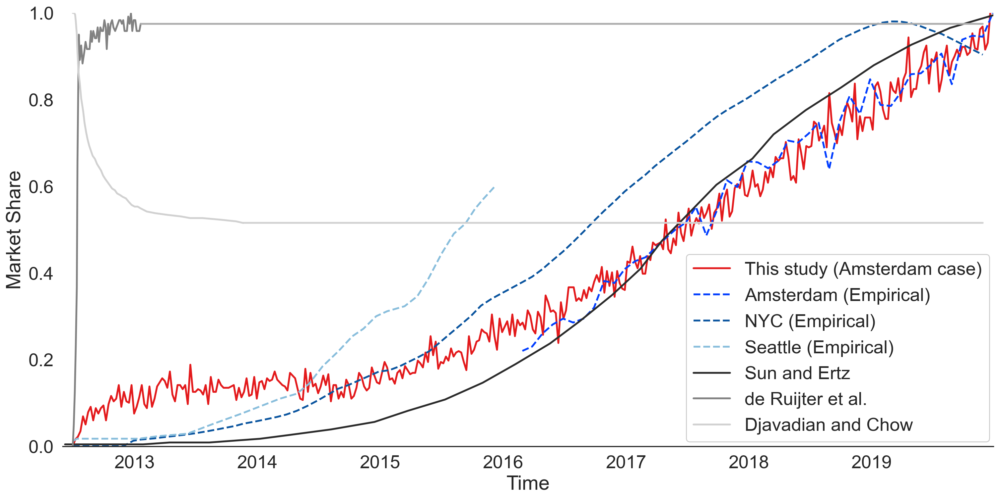

In [9]:
# Here we use min-max scaling or normalization: https://www.linkedin.com/advice/1/what-pros-cons-different-scaling-methods-data-normalization#:~:text=Data%20normalization%20and%20scaling%20can%20be%20achieved%20through%20several%20methods,dividing%20by%20the%20maximum%20value.

sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set(palette='tab10',font_scale=1.8)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=1, figsize=(16,8))
sns.despine(left=True)

bright = sns.color_palette("bright")
blues = sns.color_palette("Blues")
greys = sns.color_palette("Greys")
paired = sns.color_palette("Paired")
#Us-----------------------------------------------------------------------
me_max = me.supply_share.max()
me_last_v = me.supply_share[len(me)-1]
sns.lineplot(x=me.date, y=me.supply_share/me_max,lw=2, label = 'This study (Amsterdam case)', color=paired[5])

#Empirical-----------------------------------------------------------------------
ams_max = ams['Number_of_drivers'].max()
ams_y =ams['Number_of_drivers']# smooth(ams['Number_of_drivers'], w=9)
ams_y = [0 if math.isnan(y) else y/ams_max for y in ams_y]
ams_y[0] = 0.22; ams_y[1] = 0.23
sns.lineplot(x=ams.date, y=ams_y,lw=2, label = 'Amsterdam (Empirical)', color=bright[0], linestyle = 'dashed')

nyc_max = nyc['Unique Dispatched Vehicles'].max()
nyc_smoothed = smooth(nyc['Unique Dispatched Vehicles'], w=9)
nyc_y = nyc_smoothed[0:89]+list(nyc[89:97]['Unique Dispatched Vehicles'])+nyc_smoothed[97:]
nyc_y = [0 if math.isnan(y) else y/nyc_max for y in nyc_y]
# nyc_x = [x for x in range(1,len(nyc_y)+1)]
sns.lineplot(x=nyc.date, y=nyc_y,lw=2, label = 'NYC (Empirical)', color=blues[5], linestyle = 'dashed')

sea_max = sea.supply_share.max()
sns.lineplot(x=sea.date, y=0.6*sea.supply_share/sea_max,lw=2, label = 'Seattle (Empirical)', color=blues[2], linestyle = 'dashed')

#State-of-art-----------------------------------------------------------------------
ertz_max = ertz.supply_share.max()
ertz_last_v = ertz.supply_share[len(ertz)-1]
sns.lineplot(x=ertz.loc[0:29].date, y=ertz.loc[0:29].supply_share/ertz_max,lw=2, label = 'Sun and Ertz', color=greys[5], linestyle = 'solid')
# sns.lineplot(x=ertz.loc[30:].date, y=ertz.loc[30:].supply_share/ertz_max,lw=1, color='C2', marker = '.')

arjan_max = arjan.supply_share.max()
arjan_last_v = arjan.supply_share[len(arjan)-1]
sns.lineplot(x=arjan.date, y=arjan.supply_share/arjan_max, lw=2, label = 'de Ruijter et al.', color=greys[3], linestyle = 'solid')
aj_date = nyc.loc[6:].date; aj_date[6] = pd.Timestamp('2013-01-19')
sns.lineplot(x=aj_date, y=arjan_last_v/arjan_max, lw=2, color=greys[2], linestyle = 'solid')

djavadian_max = djavadian.supply_share.max()
djavadian_last_v = djavadian.supply_share[len(djavadian)-1]
sns.lineplot(x=djavadian.date, y=djavadian.supply_share/djavadian_max,lw=2, label = 'Djavadian and Chow', color=greys[1], linestyle = 'solid')
dj_date = nyc.loc[16:].date; dj_date[16] = pd.Timestamp('2013-11-20')
sns.lineplot(x=dj_date, y=djavadian_last_v/djavadian_max,lw=2, color=greys[1], linestyle = 'solid')

ax.set(xlabel='Time', ylabel='Market Share',xlim=(pd.Timestamp('2012-06-01 00:00:00')
,pd.Timestamp('2019-12-30 00:00:00')), ylim=(0,1))
# labels = ['Ghasemi and Kucharski','NYC (Empirical)', 'Amsterdam (Empirical)', 'Miami (Empirical)', 'Djavadian and Chow', 'Sun and Ertz']
ax.legend(frameon=True,framealpha=1, loc=(0.67,0.01))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)

plt.tight_layout()
# plt.savefig('Figs/new/1_comparison.png')

C:\Users\farno\AppData\Local\Temp/ipykernel_35744/1469938687.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  aj_date = nyc.loc[6:].date; aj_date[6] = pd.Timestamp('2013-01-19')
C:\Users\farno\AppData\Local\Temp/ipykernel_35744/1469938687.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dj_date = nyc.loc[16:].date; dj_date[16] = pd.Timestamp('2013-11-20')


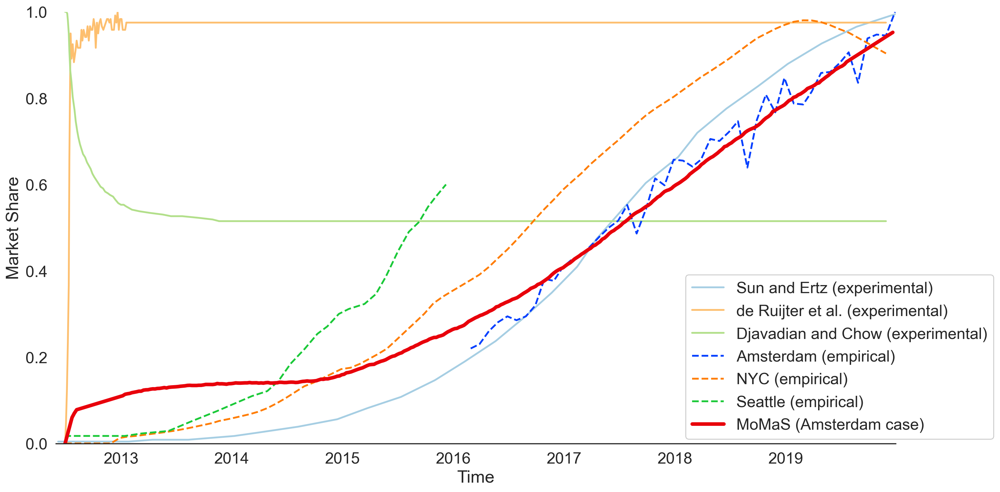

In [10]:
# Here we use min-max scaling or normalization: https://www.linkedin.com/advice/1/what-pros-cons-different-scaling-methods-data-normalization#:~:text=Data%20normalization%20and%20scaling%20can%20be%20achieved%20through%20several%20methods,dividing%20by%20the%20maximum%20value.

sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=1, figsize=(16,8))
sns.despine(left=True)

bright = sns.color_palette("bright")
blues = sns.color_palette("Blues")
greys = sns.color_palette("Greys")
paired = sns.color_palette("Paired")
#State-of-art-----------------------------------------------------------------------
ertz_max = ertz.supply_share.max()
ertz_last_v = ertz.supply_share[len(ertz)-1]
sns.lineplot(x=ertz.loc[0:29].date, y=ertz.loc[0:29].supply_share/ertz_max,lw=2, label = 'Sun and Ertz (experimental)', color=paired[0], linestyle = 'solid')
# sns.lineplot(x=ertz.loc[30:].date, y=ertz.loc[30:].supply_share/ertz_max,lw=1, color='C2', marker = '.')

arjan_max = arjan.supply_share.max()
arjan_last_v = arjan.supply_share[len(arjan)-1]
sns.lineplot(x=arjan.date, y=arjan.supply_share/arjan_max, lw=2, label = 'de Ruijter et al. (experimental)', color=paired[6], linestyle = 'solid')
aj_date = nyc.loc[6:].date; aj_date[6] = pd.Timestamp('2013-01-19')
sns.lineplot(x=aj_date, y=arjan_last_v/arjan_max, lw=2, color=paired[6], linestyle = 'solid')

djavadian_max = djavadian.supply_share.max()
djavadian_last_v = djavadian.supply_share[len(djavadian)-1]
sns.lineplot(x=djavadian.date, y=djavadian.supply_share/djavadian_max,lw=2, label = 'Djavadian and Chow (experimental)', color=paired[2], linestyle = 'solid')
dj_date = nyc.loc[16:].date; dj_date[16] = pd.Timestamp('2013-11-20')
sns.lineplot(x=dj_date, y=djavadian_last_v/djavadian_max,lw=2, color=paired[2], linestyle = 'solid')

#Empirical-----------------------------------------------------------------------
ams_max = ams['Number_of_drivers'].max()
ams_y =ams['Number_of_drivers']# smooth(ams['Number_of_drivers'], w=9)
ams_y = [0 if math.isnan(y) else y/ams_max for y in ams_y]
ams_y[0] = 0.22; ams_y[1] = 0.23
sns.lineplot(x=ams.date, y=ams_y,lw=2, label = 'Amsterdam (empirical)', color=bright[0], linestyle = 'dashed')

nyc_max = nyc['Unique Dispatched Vehicles'].max()
nyc_smoothed = smooth(nyc['Unique Dispatched Vehicles'], w=9)
nyc_y = nyc_smoothed[0:89]+list(nyc[89:97]['Unique Dispatched Vehicles'])+nyc_smoothed[97:]
nyc_y = [0 if math.isnan(y) else y/nyc_max for y in nyc_y]
# nyc_x = [x for x in range(1,len(nyc_y)+1)]
sns.lineplot(x=nyc.date, y=nyc_y,lw=2, label = 'NYC (empirical)', color=bright[1], linestyle = 'dashed')

sea_max = sea.supply_share.max()
sns.lineplot(x=sea.date, y=0.6*sea.supply_share/sea_max,lw=2, label = 'Seattle (empirical)', color=bright[2], linestyle = 'dashed')
#Us-----------------------------------------------------------------------
me_max = me.supply_share.max()
me_last_v = me.supply_share[len(me)-1]
yme = me.supply_share/me_max
yme = smooth(yme)
yme[0:5] = [0,0.02,0.04,0.06,0.07]
sns.lineplot(x=me.date, y=yme,lw=4, label = 'MoMaS (Amsterdam case)', color=bright[3])

ax.set(xlabel='Time', ylabel='Market Share',xlim=(pd.Timestamp('2012-06-01 00:00:00')
,pd.Timestamp('2019-12-30 00:00:00')), ylim=(0,1))
# labels = ['Ghasemi and Kucharski','NYC (Empirical)', 'Amsterdam (Empirical)', 'Miami (Empirical)', 'Djavadian and Chow', 'Sun and Ertz']
ax.legend(frameon=True,framealpha=1, loc=(0.75,0.01))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)

plt.tight_layout()
# plt.savefig('Figs/P1-figs/p1-Fig1.png')

In [ ]:
==========================================================

#### Fig-3: Episodes (aggregated market share)

In [2]:
df_d = pd.read_csv('data/dataframes/episodes/aggregated/episodes_demand_1000d_10000p.csv')
df_s = pd.read_csv('data/dataframes/episodes/aggregated/episodes_supply_1000d_10000p.csv')
nP = 10000
nV = 1000

In [4]:
w = 5
def smooth(y,w=w,o=1,d=2):
    from scipy.signal import savgol_filter
    nans = [float('nan') for i in range(0,d)] 
    y = nans + list(savgol_filter(y[d:],w,o))
    for i in range(0,len(y)):
        if y[i]<0:
            y[i] = 0
    return y

<AxesSubplot:ylabel='OUT'>

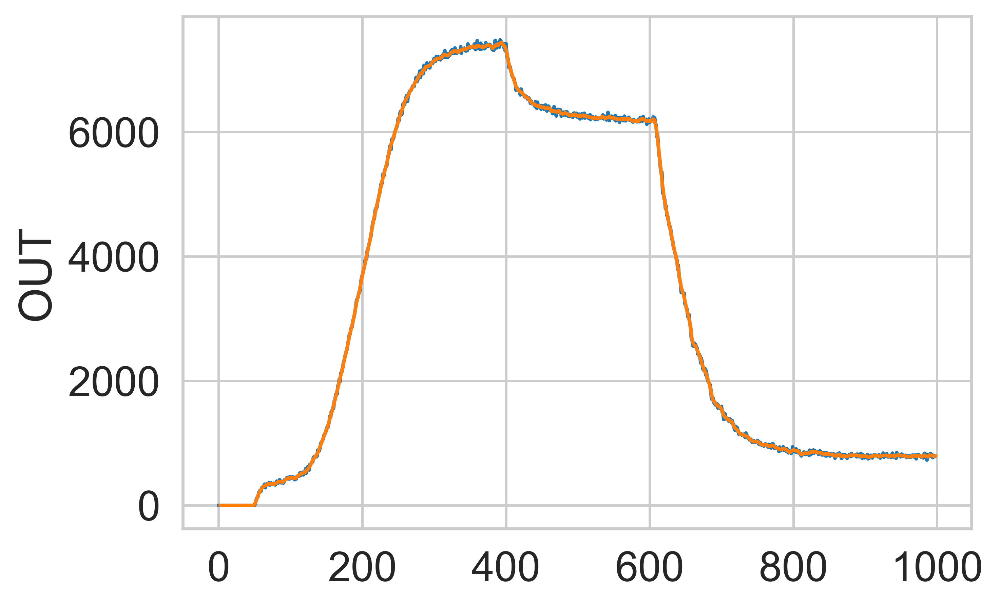

In [372]:
df_d = pd.read_csv('data/dataframes/episodes/aggregated/episodes_demand_1000d_10000p.csv')
sns.lineplot(x=df_d.index, y=df_d.OUT)
sns.lineplot(x=df_d.index, y=smooth(df_d.OUT))

In [5]:
nD = 700

df_d = pd.read_csv('data/dataframes/episodes/aggregated/episodes_demand_1000d_10000p.csv')
df_d = df_d[0:nD]

df_d.OUT = smooth(df_d.OUT)
df_d.EXPERIENCE_U = smooth(df_d.EXPERIENCE_U)
df_d.WOM_U = smooth(df_d.WOM_U)

dfd = pd.DataFrame()
dfd = pd.concat([dfd,df_d[['OUT', 'EXPERIENCE_U', 'WOM_U', 'MARKETING_U']]])

l = [0.015, 0.005, -0.0015, -0.005]
l = [x * 1.6 for x in l]
ll = [10, 40, -15, -30]
ll = [x * 1.6 for x in ll]

for i in range(0,4):
    d0 = df_d

    d0.OUT = d0.OUT+  ll[i]+ (d0.OUT*l[i])
    d0.EXPERIENCE_U = d0.EXPERIENCE_U+ (d0.EXPERIENCE_U*l[i])
    d0.WOM_U = d0.WOM_U+ (d0.WOM_U*l[i])
    
    dfd = pd.concat([dfd,d0[['OUT', 'EXPERIENCE_U', 'WOM_U', 'MARKETING_U']]])
    

dfd.loc[dfd.index[0:50], 'OUT'] = 0 
dfd.loc[dfd.index[0:w], 'EXPERIENCE_U'] = 0 
dfd.loc[dfd.index[0:w], 'WOM_U'] = 0 
dfd['ms_d'] = dfd['OUT']/10000
#####################################################################################
df_s = pd.read_csv('data/dataframes/episodes/aggregated/episodes_supply_1000d_10000p.csv')
df_s = df_s[0:nD]

df_s.OUT = smooth(df_s.OUT)
df_s.EXPERIENCE_U = smooth(df_s.EXPERIENCE_U)
df_s.WOM_U = smooth(df_s.WOM_U)

dfs = pd.DataFrame()
dfs = pd.concat([dfs,df_s[['OUT', 'EXPERIENCE_U', 'WOM_U', 'MARKETING_U']]])

l = [0.015, 0.005, -0.0015, -0.005]
les = [x * 2.2 for x in l]
l = [x * 0.6 for x in l]
ll = [10, 40, -15, -30]
ll = [x * 0.6 for x in ll]


for i in range(0,4):
    s0 = df_s

    s0.OUT = s0.OUT+  ll[i]+ (s0.OUT*l[i])
    s0.EXPERIENCE_U = s0.EXPERIENCE_U+ (s0.EXPERIENCE_U*les[i])
    s0.WOM_U = s0.WOM_U+ s0.WOM_U*les[i]
    
    dfs = pd.concat([dfs,s0[['OUT', 'EXPERIENCE_U', 'WOM_U', 'MARKETING_U']]])
    
dfs.loc[dfs.index[0:50], 'OUT'] = 0 
dfs.loc[dfs.index[0:w], 'EXPERIENCE_U'] = 0 
dfs.loc[dfs.index[0:w], 'WOM_U'] = 0 

dfs['ms_d'] = dfs['OUT']/1000

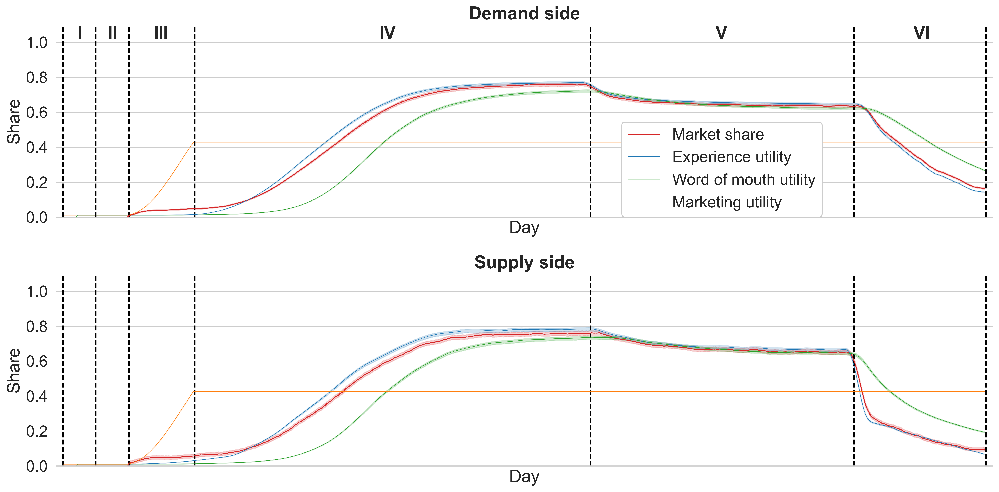

In [368]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2, figsize=(16,8))
sns.despine(left=True)

nD = 700
lw = 0.5

for row in range(0,2):
    
    if row==0:
        df = dfd; label='Demand side'
    elif row==1:
        df = dfs; label='Supply side'
        
    lx = [i for i in range(1,nD+1)]
    sns.lineplot(data=df, x=df.index, y='ms_d', label = 'Market share', color='C3', lw=lw*2, ax=ax[row])
    sns.lineplot(data=df, x=df.index, y='EXPERIENCE_U', label = 'Experience utility', color='C0', lw=lw, ax=ax[row])
    sns.lineplot(data=df, x=df.index, y='WOM_U', label = 'Word of mouth utility', color='C2', lw=lw, ax=ax[row])
    sns.lineplot(data=df, x=df.index, y='MARKETING_U', label = 'Marketing utility', color='C1', lw=lw, ax=ax[row])

    ax[row].grid(axis='x')
    ax[row].set(xlabel='Day', ylabel='Share', ylim=(0,1.1),  xlim=(-5,nD+5))
    ax[row].set_title(label,fontweight='bold', loc='center',fontsize=20)

    ax[row].vlines([0,25,50,100,400,600,700], 0, 1.1, linestyles='dashed', colors='black')
    ax[row].set_xticks([])
    # ax[0].set_xticks([0,14,25,75,289,385,481])
    # ax[0].set_xticklabels(['2012-01-01','2012-04-01','2012-07-01','2013-07-01','2018-01-01','2020-01-01','2022-01-01'],
    #                      rotation=-90)
    
for i in range(0,6):
        value = ['I','II','III','IV','V','VI']
        coords = [(11,1.02),(34,1.02),(69,1.02),(240,1.02),(495,1.02),(645,1.02)]
        ax[0].annotate(value[i], xy =coords[i], fontweight='bold')   
        
ax[0].legend(frameon=True,framealpha=1, loc=(0.604,0.0))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)
ax[1].get_legend().set_visible(False)
# ax[0].get_legend().set_visible(False)


plt.tight_layout()
# plt.savefig('Figs/P1-figs/p1-Fig3.png')

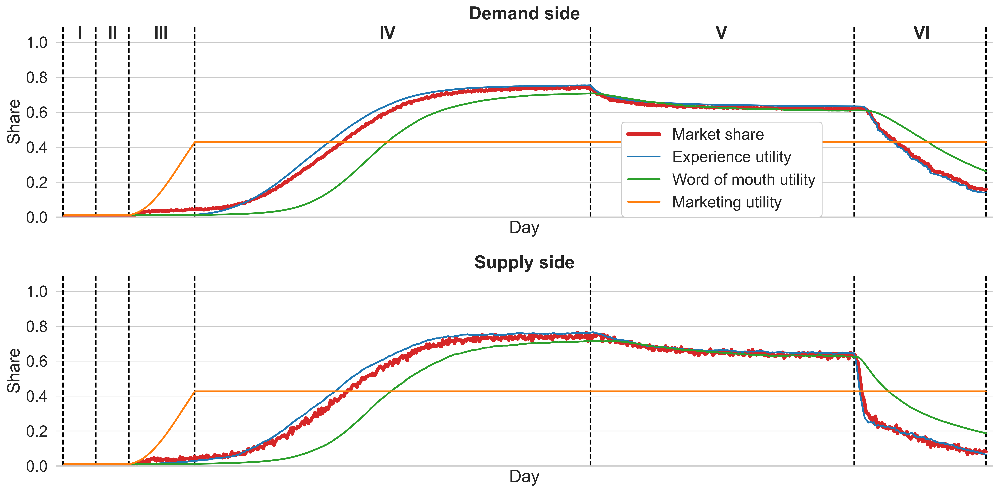

In [11]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2, figsize=(16,8))
# plt.subplots_adjust(wspace=0.3, hspace=0.4)
sns.despine(left=True)

nD = 700
df_d = df_d[0:nD]
df_ss = df_s[0:nD] 

for row in range(0,2):
    
    if row==0:
        df=df_d[0:nD]; n=nP; label='Demand side'
    elif row==1:
        df = df_s[0:nD]; n =nV; label='Supply side'
        
    lx = [i for i in range(1,nD+1)]
    sns.lineplot(x=lx, y=df.OUT/n, label = 'Market share', color='C3', lw=4, ax=ax[row])
    sns.lineplot(x=lx, y=df.EXPERIENCE_U, label = 'Experience utility', color='C0', lw=2, ax=ax[row])
    sns.lineplot(x=lx, y=df.WOM_U, label = 'Word of mouth utility', color='C2', lw=2, ax=ax[row])
    sns.lineplot(x=lx, y=df.MARKETING_U, label = 'Marketing utility', color='C1', lw=2, ax=ax[row])

    ax[row].grid(axis='x')
    ax[row].set(xlabel='Day', ylabel='Share', ylim=(0,1.1),  xlim=(-5,nD+5))
    ax[row].set_title(label,fontweight='bold', loc='center',fontsize=20)

    ax[row].vlines([0,25,50,100,400,600,700], 0, 1.1, linestyles='dashed', colors='black')
    ax[row].set_xticks([])
    # ax[0].set_xticks([0,14,25,75,289,385,481])
    # ax[0].set_xticklabels(['2012-01-01','2012-04-01','2012-07-01','2013-07-01','2018-01-01','2020-01-01','2022-01-01'],
    #                      rotation=-90)
    
for i in range(0,6):
        value = ['I','II','III','IV','V','VI']
        coords = [(11,1.02),(34,1.02),(69,1.02),(240,1.02),(495,1.02),(645,1.02)]
        ax[0].annotate(value[i], xy =coords[i], fontweight='bold')   
        
ax[0].legend(frameon=True,framealpha=1, loc=(0.604,0.0))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)
ax[1].get_legend().set_visible(False)
# ax[0].get_legend().set_visible(False)


plt.tight_layout()
# plt.savefig('Figs/P1-figs/p1-Fig3.png')

#### Fig-4: Episodes (aggregated performance)

In [6]:
def smooth(y,w=51,o=1,d=2):
    from scipy.signal import savgol_filter
    nans = [float('nan') for i in range(0,d)] 
    y = nans + list(savgol_filter(y[d:],w,o))
    for i in range(0,len(y)):
        if y[i]<0:
            y[i] = 0
    return y

In [7]:
df_dd.iloc[0:51] = df_dd.loc[51]
df_ss.iloc[0:51] = df_ss.loc[51]

NameError: name 'df_dd' is not defined

In [8]:
df_d = pd.read_csv('data/dataframes/episodes/aggregated/episodes_demand_1000d_10000p.csv')
df_s = pd.read_csv('data/dataframes/episodes/aggregated/episodes_supply_1000d_10000p.csv')
nD = 700
df_dd = df_d[0:nD]
df_ss = df_s[0:nD] 

df_dd.iloc[0:51] = df_dd.loc[51]
df_ss.iloc[0:51] = df_ss.loc[51]
###################################
wt = smooth(df_dd.ACTUAL_WT)[50:500]
wt.extend(wt[400:450])
wt.extend(wt[400:450])
wt.extend(df_d.ACTUAL_WT[600:610])
wt.extend([6])

wtx = [i for i in range(51,611)]
wtx.extend([700])
####################################
ptr = df_ss.ARRIVES_AT_PICKUP/(df_ss.nRIDES*60)
pt = smooth(ptr)[50:500]
pt.extend(pt[400:450])
pt.extend(pt[400:450])
pt.extend(ptr[600:610])
pt.extend([3.8])
###################################
mt = smooth(df_dd.MATCHING_T)[50:500]
mt.extend(mt[400:450])
mt.extend(mt[400:450])
mt.extend(df_d.MATCHING_T[600:610])
mt.extend([2.2])
####################################
ais = smooth(df_ss.ACTUAL_INC)
ai = ais[50:350]
ai.extend([55.9 for i in range(0,50)])
ai.extend(df_ss.ACTUAL_INC[400:408])
ai.extend([50.348051 for i in range(408,600)])
ai.extend(df_ss.ACTUAL_INC[600:610])
ai.extend([38])

aix = [i for i in range(51,611)]
aix.extend([700])
####################################
r = smooth(df_ss.REVENUE)[50:350]
r.extend([71.2 for i in range(0,50)])
r.extend(df_ss.REVENUE[400:408])
r.extend([65 for i in range(408,600)])
r.extend(df_ss.REVENUE[600:610])
r.extend([73])
###################################
c = smooth(df_ss.COST)[50:350]
c.extend([15.36 for i in range(0,50)])
c.extend(df_ss.COST[400:408])
c.extend([13.8 for i in range(408,600)])
c.extend(df_ss.COST[600:610])
c.extend([35])
####################################
itr = (df_ss.IDLE_TIME/60)-60*2
it = smooth(itr)[50:350]
it.extend([127.6 for i in range(0,50)])
it.extend(itr[400:408])
it.extend([137.99 for i in range(408,600)])
it.extend(itr[600:610])
it.extend([0])

C:\Users\farno\anaconda3\lib\site-packages\pandas\core\indexing.py:1797: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, v, pi)


In [270]:
itr[600:610]

600    136.154713
601    129.451772
602    126.649041
603    110.819260
604     93.688196
605     57.121141
606     40.957614
607      9.706546
608      2.178135
609      0.956689
Name: IDLE_TIME, dtype: float64

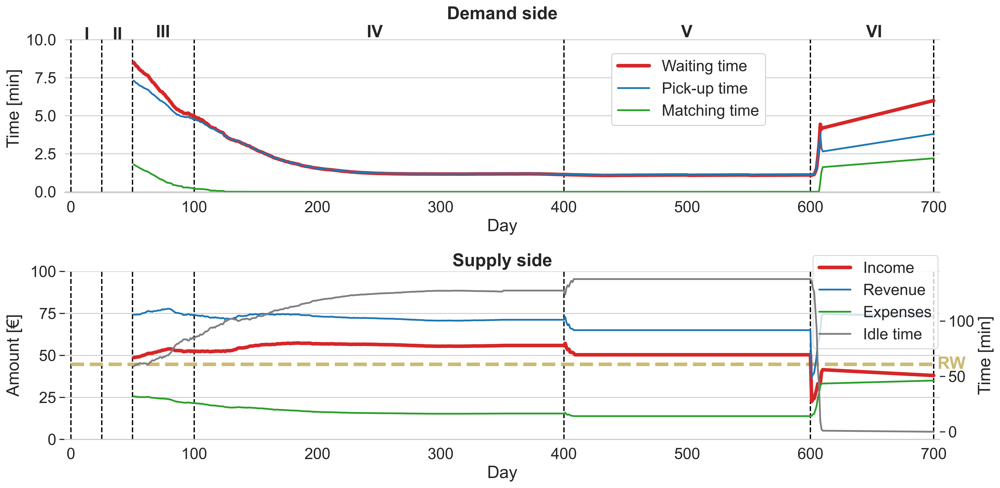

In [14]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2, figsize=(16,8))
# plt.subplots_adjust(wspace=0.3, hspace=0.4)
sns.despine(left=True)

RW = 4*11.16
nD = 700
# df_dd = df_d[0:nD]
# df_ss = df_s[0:nD] 

lx = [i for i in range(51,nD+1)]
# lxx= [i for i in range(0,nD+1)]

sns.lineplot(x=wtx, y=wt, label = 'Waiting time', color='C3',lw=4, ax=ax[0])#, marker='o')
sns.lineplot(x=wtx, y=pt, label = 'Pick-up time', color='C0',lw=2, ax=ax[0])#, marker='o')
sns.lineplot(x=wtx, y=mt, label = 'Matching time', color='C2',lw=2, ax=ax[0])#, marker='o')

sns.lineplot(x=aix, y=ai, label = 'Income', color='C3',lw=4, ax=ax[1])#, marker='o')
sns.lineplot(x=aix, y=r, label = 'Revenue', color='C0',lw=2, ax=ax[1])#, marker='o')
sns.lineplot(x=aix, y=c, label = 'Expenses', color='C2',lw=2, ax=ax[1])#, marker='o')ax.twinx()

ax11 = ax[1].twinx()
sns.lineplot(x=aix, y=it, label = 'Idle time', color='C7',lw=2, ax=ax11)#, marker='o')
# ax11.set(ylabel='Time [min]', ylim=(-0.05,9),  xlim=(-5,nD+5))
ax11.grid(b=None)
ax11.set(xlabel='', ylabel='Time [min]')

for row in [0,1]:
    if row==0:
        ax[row].set_title(label='Demand side',fontweight='bold', loc='center',fontsize=20)
        ax[row].vlines([0,25,50,100,400,600,700], 0, 10, linestyles='dashed', colors='black')
        ax[row].set(xlabel='Day', ylabel='Time [min]', ylim=(-0.05,11),  xlim=(-5,nD+5))
    elif row==1:
        ax[row].set_title(label='Supply side',fontweight='bold', loc='center',fontsize=20)
        ax[row].vlines([0,25,50,100,400,600,700], 0, 100, linestyles='dashed', colors='black')
        ax[row].set(xlabel='Day', ylabel='Amount [€]', ylim=(-0.05,100),  xlim=(-5,nD+5))
        
    ax[row].grid(axis='x')
    # ax[row].set_xticks([])
    
    

    # ax[0].set_xticks([0,14,25,75,289,385,481])
    # ax[0].set_xticklabels(['2012-01-01','2012-04-01','2012-07-01','2013-07-01','2018-01-01','2020-01-01','2022-01-01'],
    #                      rotation=-90)

    
for i in range(0,6):
    value = ['I','II','III','IV','V','VI']
    coords = [(11,10.02),(34,10.02),(69,10.16),(240,10.16),(495,10.16),(645,10.16)]
    ax[0].annotate(value[i], xy =coords[i], fontweight='bold')
    
ax[1].hlines([RW], 0, nD, linestyles='dashed', colors='y', lw=4)
ax[1].annotate('RW', xy =(nD+3,42), fontweight='bold', color='y')    


lines, labels = ax[1].get_legend_handles_labels()
lines2, labels2 = ax11.get_legend_handles_labels()
ax[1].legend(lines + lines2, labels + labels2,framealpha=0.8, loc=(0.855,0.54))
ax11.legend().remove()

ax[1].set_title(label='Supply side',fontweight='bold', loc='center',fontsize=20)

ax[0].legend(frameon=True,framealpha=1, loc=(0.625,0.4))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)
# ax[1].get_legend().set_visible(False)
sns.despine(left=True)
fig.align_ylabels()
# ax[1].legend().remove()

plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig4.png')

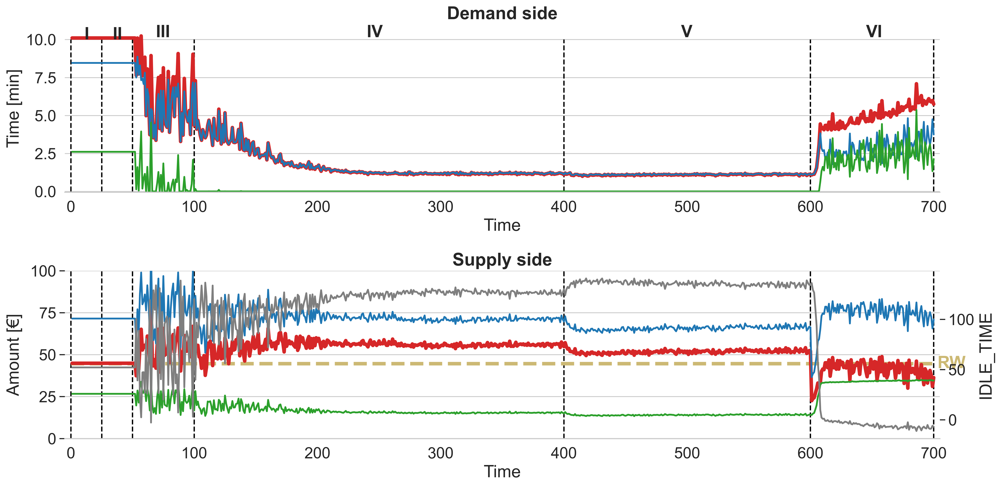

In [259]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2, figsize=(16,8))
# plt.subplots_adjust(wspace=0.3, hspace=0.4)
sns.despine(left=True)

RW = 4*11.16
nD = 700
df_dd = df_d[0:nD]
df_ss = df_s[0:nD] 

lx = [i for i in range(1,nD+1)]
# lxx= [i for i in range(0,nD+1)]

sns.lineplot(x=lx, y=df_dd.ACTUAL_WT, label = 'Waiting time', color='C3',lw=4, ax=ax[0])#, marker='o')
sns.lineplot(x=lx, y=df_ss.ARRIVES_AT_PICKUP/(df_ss.nRIDES*60), label = 'Pick-up time', color='C0',lw=2, ax=ax[0])#, marker='o')
sns.lineplot(x=lx, y=df_dd.MATCHING_T, label = 'Matching time', color='C2',lw=2, ax=ax[0])#, marker='o')

sns.lineplot(x=lx, y=df_ss.ACTUAL_INC, label = 'Income', color='C3',lw=4, ax=ax[1])#, marker='o')
sns.lineplot(x=lx, y=df_ss.REVENUE, label = 'Revenue', color='C0',lw=2, ax=ax[1])#, marker='o')
sns.lineplot(x=lx, y=df_ss.COST, label = 'Expenses', color='C2',lw=2, ax=ax[1])#, marker='o')ax.twinx()

ax11 = ax[1].twinx()
sns.lineplot(x=lx, y=(df_ss.IDLE_TIME/60)-60*2, label = 'Idle time', color='C7',lw=2, ax=ax11)#, marker='o')
# ax11.set(ylabel='Time [min]', ylim=(-0.05,9),  xlim=(-5,nD+5))
ax11.grid(b=None)

for row in [0,1]:
    if row==0:
        ax[row].set_title(label='Demand side',fontweight='bold', loc='center',fontsize=20)
        ax[row].vlines([0,25,50,100,400,600,700], 0, 10, linestyles='dashed', colors='black')
        ax[row].set(xlabel='Time', ylabel='Time [min]', ylim=(-0.05,11),  xlim=(-5,nD+5))
    elif row==1:
        ax[row].set_title(label='Supply side',fontweight='bold', loc='center',fontsize=20)
        ax[row].vlines([0,25,50,100,400,600,700], 0, 100, linestyles='dashed', colors='black')
        ax[row].set(xlabel='Time', ylabel='Amount [€]', ylim=(-0.05,100),  xlim=(-5,nD+5))
        
    ax[row].grid(axis='x')
    # ax[row].set_xticks([])
    
    

    # ax[0].set_xticks([0,14,25,75,289,385,481])
    # ax[0].set_xticklabels(['2012-01-01','2012-04-01','2012-07-01','2013-07-01','2018-01-01','2020-01-01','2022-01-01'],
    #                      rotation=-90)

    
for i in range(0,6):
    value = ['I','II','III','IV','V','VI']
    coords = [(11,10.02),(34,10.02),(69,10.16),(240,10.16),(495,10.16),(645,10.16)]
    ax[0].annotate(value[i], xy =coords[i], fontweight='bold')
    
ax[1].hlines([RW], 0, nD, linestyles='dashed', colors='y', lw=4)
ax[1].annotate('RW', xy =(nD+3,42), fontweight='bold', color='y')    


lines, labels = ax[1].get_legend_handles_labels()
lines2, labels2 = ax11.get_legend_handles_labels()
ax[1].legend(lines + lines2, labels + labels2,framealpha=0.8, loc=(0.855,0.54))
ax11.legend().remove()

ax[1].set_title(label='Supply side',fontweight='bold', loc='center',fontsize=20)

ax[0].legend(frameon=True,framealpha=1, loc=(0.625,0.4))#,  bbox_to_anchor=(0.75, 1.24), ncol=4)
# ax[1].get_legend().set_visible(False)
sns.despine(left=True)
fig.align_ylabels()

ax[0].legend().remove()
ax[1].legend().remove()


plt.tight_layout()
# plt.savefig('Figs/P1-figs/Fig4.png')

In [274]:
4*11.16

44.64

#### Fig-5: Individual evolutions

In [3]:
B_Experience=0.7; B_Marketing=0.1; B_WOM=0.2; m=7

pax_1 = pd.DataFrame(); pax_2 = pd.DataFrame();pax_3 = pd.DataFrame(); pax_4 = pd.DataFrame()
pax_5 = pd.DataFrame(); pax_6 = pd.DataFrame();pax_7 = pd.DataFrame(); pax_8 = pd.DataFrame()

veh_1 = pd.DataFrame(); veh_2 = pd.DataFrame(); veh_3 = pd.DataFrame(); veh_4 = pd.DataFrame()
veh_5 = pd.DataFrame(); veh_6 = pd.DataFrame(); veh_7 = pd.DataFrame(); veh_8 = pd.DataFrame()

agent = [pax_1, pax_2,pax_3,pax_4,pax_5,pax_6,pax_7,pax_8, veh_1, veh_2,veh_3,veh_4,veh_5,veh_6,veh_7,veh_8]

ids = [52,24,60,61,62,63,64,65, 349,14,598,101,102,103,104,105]
nD=700
n=0

for i in ids:
    ye = []; ym = []; yw = []; yu = []; yp = []
    if n <2:
        for d in range(0,nD):
            day = pd.read_csv('data/dataframes/episodes/days/episodes/pax_day_{}.csv'.format(d))
            ye.append(day.loc[i].EXPERIENCE_U)
            ym.append(day.loc[i].MARKETING_U)
            yw.append(day.loc[i].WOM_U)
            u = (B_Experience*ye[-1])+(B_Marketing*ym[-1])+(B_WOM*yw[-1])
            yu.append(u)
            yp.append((math.exp(m*u))/(math.exp(m*u) + math.exp(m*0.5)))
        agent[n]['EXPERIENCE_U'] = ye; agent[n]['WOM_U'] = yw; agent[n]['MARKETING_U'] = ym; agent[n]['PROBABILITY'] = yp     
    else:
        for d in range(0,nD):
            day = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(d))
            ye.append(day.loc[i].EXPERIENCE_U)
            ym.append(day.loc[i].MARKETING_U)
            yw.append(day.loc[i].WOM_U)
            u = (B_Experience*ye[-1])+(B_Marketing*ym[-1])+(B_WOM*yw[-1])
            yu.append(u)
            yp.append((math.exp(m*u))/(math.exp(m*u) + math.exp(m*0.5)))
        agent[n]['EXPERIENCE_U'] = ye; agent[n]['WOM_U'] = yw; agent[n]['MARKETING_U'] = ym; agent[n]['PROBABILITY'] = yp     
    n = n+1

C:\Users\farno\AppData\Local\Temp/ipykernel_20788/2327035781.py:34: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


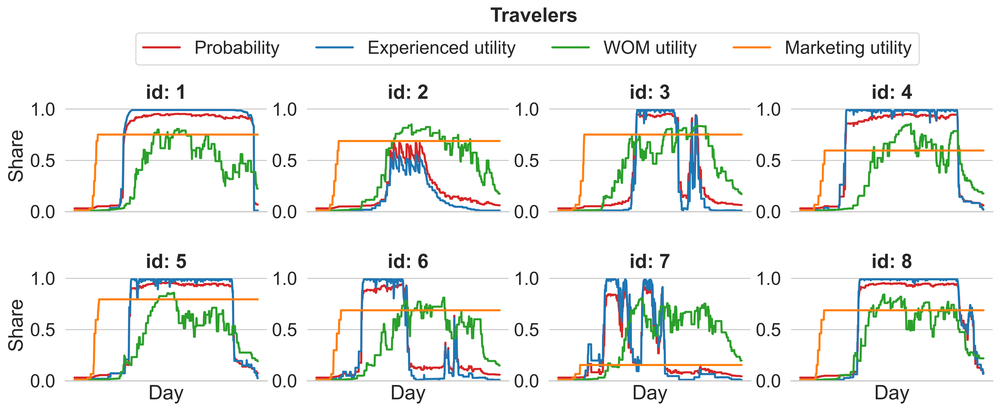

In [4]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2,ncols=4, figsize=(16,5))
sns.despine(left=True)
lw=2
n = 0

for n in range(0,16):
    
    x = [i for i in range(1,nD+1)]
    if n<8:
        axn = 0 if n<4 else 1
        sns.lineplot(x=x, y=agent[n].PROBABILITY, label = 'Probability', color='C3', linewidth=lw, ax=ax[axn,n-axn*4])
        sns.lineplot(x=x, y=agent[n].EXPERIENCE_U, label = 'Experienced utility', color='C0', lw=lw, ax=ax[axn,n-axn*4])#, marker='o')
        sns.lineplot(x=x, y=agent[n].WOM_U, label = 'WOM utility', color='C2',lw=lw, ax=ax[axn,n-axn*4])#, marker='o')
        sns.lineplot(x=x, y=agent[n].MARKETING_U, label = 'Marketing utility', color='C1',lw=lw, ax=ax[axn,n-axn*4])#, marker='o')

        ax[axn,n-axn*4].set(xlabel='', ylabel='', ylim=(0,1.1))
        ax[axn,n-axn*4].grid(axis='x')
        ax[axn,n-axn*4].get_legend().set_visible(False)
        ax[axn,n-axn*4].set_xticks([])
        ax[axn,n-axn*4].set_title('id: {}'.format(n+1),fontweight='bold', pad=-0)
        
ax[1,0].set(xlabel='Day', ylabel='Share', ylim=(0,1.1));ax[1,1].set(xlabel='Day', ylabel='', ylim=(0,1.1))
ax[1,2].set(xlabel='Day', ylabel='', ylim=(0,1.1));ax[1,3].set(xlabel='Day', ylabel='', ylim=(0,1.1))
ax[0,0].set(xlabel='', ylabel='Share', ylim=(0,1.1))

ax[0,0].get_legend().set_visible(True)
ax[0,0].legend(loc=(0.35,1.3), frameon=True, ncol=4)

fig.text(0.48, 1.1, 'Travelers', va='center', rotation='horizontal', fontweight='bold')
plt.subplots_adjust(hspace=0.5)
plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig5a.png', bbox_inches='tight')

C:\Users\farno\AppData\Local\Temp/ipykernel_20788/987210623.py:34: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


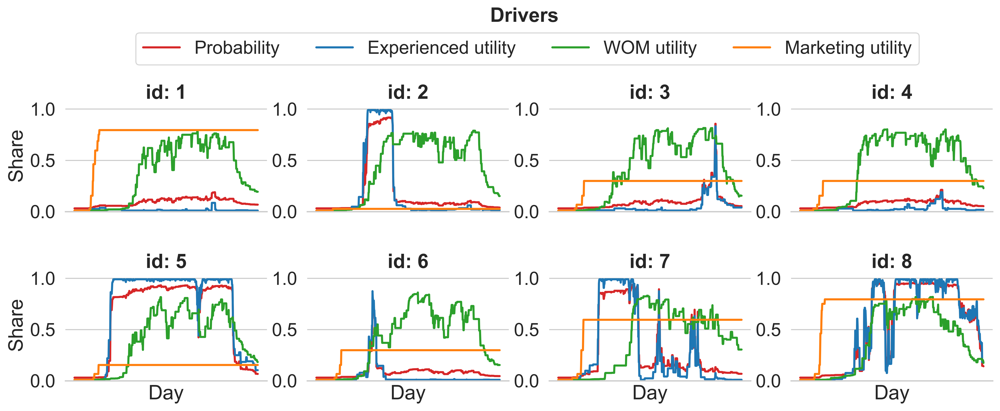

In [5]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2,ncols=4, figsize=(16,5))
sns.despine(left=True)
lw=2
n = 0

for n in range(0,16):
    
    x = [i for i in range(1,nD+1)]
    if n>7:
        axn = 0 if n<12 else 1
        sns.lineplot(x=x, y=agent[n].PROBABILITY, label = 'Probability', color='C3', linewidth=lw, ax=ax[axn,n-(axn+2)*4])
        sns.lineplot(x=x, y=agent[n].EXPERIENCE_U, label = 'Experienced utility', color='C0', lw=lw, ax=ax[axn,n-(axn+2)*4])#, marker='o')
        sns.lineplot(x=x, y=agent[n].WOM_U, label = 'WOM utility', color='C2',lw=lw, ax=ax[axn,n-(axn+2)*4])#, marker='o')
        sns.lineplot(x=x, y=agent[n].MARKETING_U, label = 'Marketing utility', color='C1',lw=lw, ax=ax[axn,n-(axn+2)*4])#, marker='o')

        ax[axn,n-(axn+2)*4].set(xlabel='', ylabel='', ylim=(0,1.1))
        ax[axn,n-(axn+2)*4].grid(axis='x')
        ax[axn,n-(axn+2)*4].get_legend().set_visible(False)
        ax[axn,n-(axn+2)*4].set_xticks([])
        ax[axn,n-(axn+2)*4].set_title('id: {}'.format(n-7),fontweight='bold', pad=-0)
        
ax[1,0].set(xlabel='Day', ylabel='Share', ylim=(0,1.1));ax[1,1].set(xlabel='Day', ylabel='', ylim=(0,1.1))
ax[1,2].set(xlabel='Day', ylabel='', ylim=(0,1.1));ax[1,3].set(xlabel='Day', ylabel='', ylim=(0,1.1))
ax[0,0].set(xlabel='', ylabel='Share', ylim=(0,1.1))

ax[0,0].get_legend().set_visible(True)
ax[0,0].legend(loc=(0.35,1.3), frameon=True, ncol=4)

fig.text(0.48, 1.1, 'Drivers', va='center', rotation='horizontal', fontweight='bold')
plt.subplots_adjust(hspace=0.5)
plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig5b.png', bbox_inches='tight')

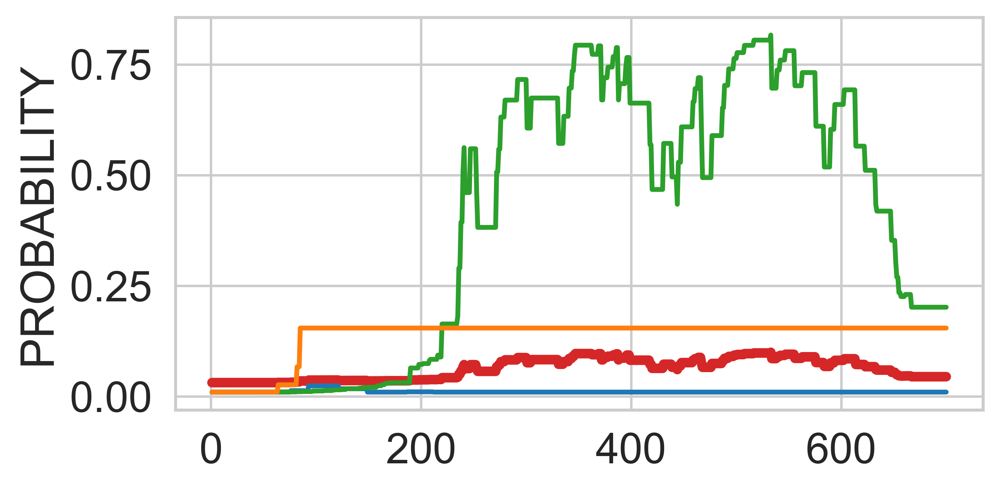

In [277]:
B_Experience=0.7; B_Marketing=0.1; B_WOM=0.2; m=7

pax_a = pd.DataFrame(); pax_b = pd.DataFrame()
veh_a = pd.DataFrame(); veh_b = pd.DataFrame()
agent = [pax_a, pax_b, veh_a, veh_b]
#349-598
i = 995
n = 0
nD = 700
x = [i for i in range(1,nD+1)]

ye = []; ym = []; yw = []; yu = []; yp = []
for d in range(0,nD):
    day = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(d))
    ye.append(day.loc[i].EXPERIENCE_U)
    ym.append(day.loc[i].MARKETING_U)
    yw.append(day.loc[i].WOM_U)
    u = (B_Experience*ye[-1])+(B_Marketing*ym[-1])+(B_WOM*yw[-1])
    yu.append(u)
    yp.append((math.exp(m*u))/(math.exp(m*u) + math.exp(m*0.5)))
agent[n]['EXPERIENCE_U'] = ye; agent[n]['WOM_U'] = yw; agent[n]['MARKETING_U'] = ym; agent[n]['PROBABILITY'] = yp     

fig, ax = plt.subplots(figsize=(6,3))

sns.lineplot(x=x, y=agent[n].PROBABILITY, label = 'Probability', color='C3', linewidth=4)
sns.lineplot(x=x, y=agent[n].EXPERIENCE_U, label = 'Experienced utility', color='C0', lw=2)#, marker='o')
sns.lineplot(x=x, y=agent[n].WOM_U, label = 'WOM utility', color='C2',lw=2)#, marker='o')
sns.lineplot(x=x, y=agent[n].MARKETING_U, label = 'Marketing utility', color='C1',lw=2)#, marker='o')

ax.get_legend().set_visible(False)

In [136]:
t = 0.05
for i in range(0,999):
    n = 0

    df = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(100))
    if df.loc[i].EXPERIENCE_U<t:
        n = n+1
        
    df = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(200))
    if df.loc[i].EXPERIENCE_U<t:
        n = n+1
    
    df = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(300))
    if df.loc[i].EXPERIENCE_U<t:
        n = n+1
    
    df = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(400))
    if df.loc[i].EXPERIENCE_U<t:
        n = n+1
        
    df = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(500))
    if df.loc[i].EXPERIENCE_U<t:
        n = n+1
    
    if n>4:
        print(i)

67
79
118
133
219
223
225
334
346
349
513
535
570
598
600
612
613
640
695
708
740
801
805
813
816
878
960
995


In [133]:
d=300
df = pd.read_csv('data/dataframes/episodes/days/episodes/veh_day_{}.csv'.format(d))
df.loc[0]

veh                                 2
nRIDES                            0.0
nREJECTED                         0.0
nDAYS_WORKED                     29.0
DRIVING_TIME                      0.0
IDLE_TIME                         0.0
PICKUP_DIST                       0.0
DRIVING_DIST                      0.0
REVENUE                           0.0
COST                              0.0
COMMISSION                        0.0
TRIP_FARE                         0.0
ACTUAL_INC                        0.0
OUT                              True
mu                                  0
INFORMED                         True
EXPERIENCE_U                  0.13674
MARKETING_U                  0.595287
WOM_U                        0.770962
STARTS_DAY                          0
OPENS_APP                           0
RECEIVES_REQUEST                  0.0
ACCEPTS_REQUEST                   0.0
REJECTS_REQUEST                     0
IS_ACCEPTED_BY_TRAVELLER          0.0
IS_REJECTED_BY_TRAVELLER            0
ARRIVES_AT_P

#### Fig-6: Sensitivy

In [221]:
import datetime
import matplotlib.dates as mdates

nD = 500
base = pd.Timestamp('2012-07-01')
n_days = nD
step = 7.6 #7.6
timestamp = [base + datetime.timedelta(days=step*x) for x in range(n_days)]

df_d = pd.read_csv('data/dataframes/baseline_demand1.csv'); df_d['date'] = timestamp
df_s = pd.read_csv('data/dataframes/baseline_supply1.csv'); df_s['date'] = timestamp

df_c30_d = pd.read_csv('data/dataframes/comm_30_demand1.csv'); df_c30_d['date'] = timestamp
df_c30_s = pd.read_csv('data/dataframes/comm_30_supply1.csv'); df_c30_s['date'] = timestamp

df_c10_d = pd.read_csv('data/dataframes/comm_10_demand1.csv'); df_c10_d['date'] = timestamp
df_c10_s = pd.read_csv('data/dataframes/comm_10_supply1.csv'); df_c10_s['date'] = timestamp

df_f18_d = pd.read_csv('data/dataframes/fare_1.8_demand1.csv'); df_f18_d['date'] = timestamp
df_f18_s = pd.read_csv('data/dataframes/fare_1.8_supply1.csv'); df_f18_s['date'] = timestamp

df_f06_d = pd.read_csv('data/dataframes/fare_0.6_demand1.csv'); df_f06_d['date'] = timestamp
df_f06_s = pd.read_csv('data/dataframes/fare_0.6_supply1.csv'); df_f06_s['date'] = timestamp

df_disc50_d = pd.read_csv('data/dataframes/disc_50%_demand1.csv'); df_disc50_d['date'] = timestamp
df_disc50_s = pd.read_csv('data/dataframes/disc_50%_supply1.csv'); df_disc50_s['date'] = timestamp

df_incen50_d = pd.read_csv('data/dataframes/incen_50%_demand1.csv'); df_incen50_d['date'] = timestamp
df_incen50_s = pd.read_csv('data/dataframes/incen_50%_supply1.csv'); df_incen50_s['date'] = timestamp

In [69]:
(df_incen50_d.plat_revenue*df_incen50_d.OUT)

0             NaN
1        55.78880
2       145.68000
3       228.19736
4       238.15008
          ...    
495    7423.92592
496    7486.74248
497    7438.75200
498    7426.04064
499    7516.78176
Length: 500, dtype: float64

In [68]:
(((df_incen50_d.plat_revenue*df_incen50_d.OUT)*100)/20)-(df_incen50_s.REVENUE*df_incen50_s.OUT)

0            NaN
1       -55.5584
2      -117.5520
3      -193.4900
4      -219.2208
         ...    
495    5158.5640
496    4790.9556
497    4910.7392
498    4731.0128
499    4841.9264
Length: 500, dtype: float64

In [67]:
df_incen50_s.REVENUE*df_incen50_s.OUT

0             NaN
1        334.5024
2        845.9520
3       1334.4768
4       1409.9712
          ...    
495    31961.0656
496    32642.7568
497    32283.0208
498    32399.1904
499    32741.9824
Length: 500, dtype: float64

In [49]:
df_incen50_s.REVENUE[:30]
df_s.REVENUE[250:300]

250    11.080420
251    10.736099
252    10.716311
253    10.526939
254    12.276447
255     9.760404
256    10.292750
257    13.951058
258    10.556160
259    10.647774
260    13.600032
261    14.887802
262    10.418800
263    13.184657
264    11.719162
265    12.264021
266    11.314129
267    12.418667
268    14.367100
269    12.981536
270    11.970723
271    11.540538
272    12.414147
273    13.651979
274    10.707107
275    12.552493
276    14.296744
277    10.225887
278    15.944750
279    11.813147
280    13.466726
281    13.553456
282    14.432992
283    15.593234
284    13.517663
285    14.689607
286    13.140577
287    14.720726
288    12.963322
289    13.554537
290    14.544957
291    12.598667
292    14.873402
293    14.911857
294    14.520100
295    12.398382
296    14.688154
297    12.489600
298    14.480483
299    15.157844
Name: REVENUE, dtype: float64

In [83]:
df_d = pd.DataFrame()

nD = 500
nP = 10000
nV = 1000
base = pd.Timestamp('2012-07-01')
n_days = nD
step = 7.6 #7.6
timestamp = [base + datetime.timedelta(days=step*x) for x in range(n_days)]

df_base = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/baseline_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/baseline_supply{}.csv'.format(r))
    df = pd.DataFrame()
    df['rev'] = d['OUT']*d['plat_revenue']
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_base = pd.concat([df_base,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_base.at[0, 'rev'] = 0
#-------------------------------------------------------------------------
df_c30 = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/comm_30_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/comm_30_supply{}.csv'.format(r))
    df = pd.DataFrame()
    df['rev'] = d['OUT']*d['plat_revenue']
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_c30 = pd.concat([df_c30,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_c30.at[0, 'rev'] = 0

#-------------------------------------------------------------------------
df_c10 = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/comm_10_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/comm_10_supply{}.csv'.format(r))
    df = pd.DataFrame()
    df['rev'] = d['OUT']*d['plat_revenue']
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_c10 = pd.concat([df_c10,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_c10.at[0, 'rev'] = 0

#-------------------------------------------------------------------------
df_f18 = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/fare_1.8_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/fare_1.8_supply{}.csv'.format(r))
    df = pd.DataFrame()
    df['rev'] = d['OUT']*d['plat_revenue']
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_f18 = pd.concat([df_f18,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_f18.at[0, 'rev'] = 0

#-------------------------------------------------------------------------
df_f06 = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/fare_0.6_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/fare_0.6_supply{}.csv'.format(r))
    df = pd.DataFrame()
    df['rev'] = d['OUT']*d['plat_revenue']
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_f06 = pd.concat([df_f06,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_f06.at[0, 'rev'] = 0

#-------------------------------------------------------------------------
df_disc50 = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/disc_50%_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/disc_50%_supply{}.csv'.format(r))
    df = pd.DataFrame()
    df['rev'] = d['OUT']*d['plat_revenue']
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_disc50 = pd.concat([df_disc50,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_disc50.at[0, 'rev'] = 0

#-------------------------------------------------------------------------
df_incen50 = pd.DataFrame()
for r in range(1,6):
    
    d = pd.read_csv('data/dataframes/incen_50%_demand{}.csv'.format(r))
    s = pd.read_csv('data/dataframes/incen_50%_supply{}.csv'.format(r))
    df = pd.DataFrame()    
    df['rev'] = (((d['OUT']*d['plat_revenue'])*100)/20) - (s.REVENUE*s.OUT)
    df['ms_d'] = d['OUT']/nP
    df['ms_s'] = s['OUT']/nV
    df['date'] = timestamp
    df['rep_num'] = r
    df_incen50 = pd.concat([df_incen50,df[['date','rep_num', 'ms_d', 'ms_s', 'rev']]])
df_incen50.at[0, 'rev'] = 0


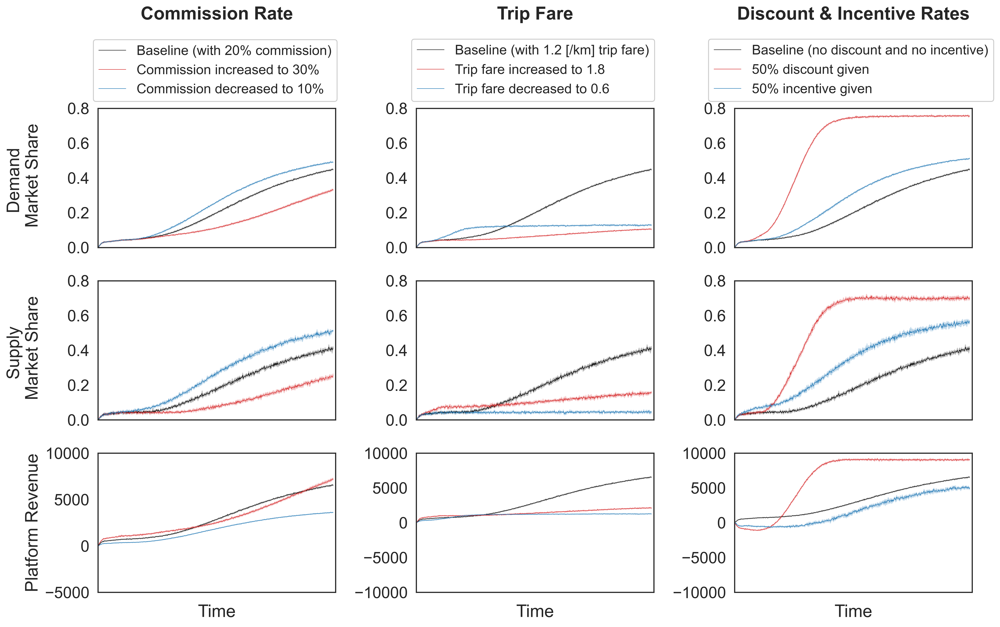

In [236]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(16,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)
# sns.despine(left=True)

pallete = sns.color_palette("tab10")
c2=pallete[3]; c3=pallete[0]
lw = 0.5
# c2='darkred'; c3='darkblue'
start_date = pd.Timestamp('2012-07-01 00:00:00'); end_date = pd.Timestamp('2022-12-30 00:00:00')


for row in range(0,3):
    
    lx = [i for i in range(1,nD+1)]
    
    if row==0:
        n=10000; label='Demand side'
        sns.lineplot(data=df_base, x='date', y='ms_d', label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][0])
        sns.lineplot(data=df_c30, x='date', y='ms_d', label = 'Commission increased to 30%', color=c2, lw=lw, ax=ax[row][0])
        sns.lineplot(data=df_c10, x='date', y='ms_d', label = 'Commission decreased to 10%', color=c3, lw=lw, ax=ax[row][0])
        
        sns.lineplot(data=df_base, x='date', y='ms_d', label = 'Baseline (with 1.2 [/km] trip fare)', color='black', lw=lw, ax=ax[row][1])
        sns.lineplot(data=df_f18, x='date', y='ms_d', label = 'Trip fare increased to 1.8', color=c2, lw=lw, ax=ax[row][1])
        sns.lineplot(data=df_f06, x='date', y='ms_d', label = 'Trip fare decreased to 0.6', color=c3, lw=lw, ax=ax[row][1])

        sns.lineplot(data=df_base, x='date', y='ms_d', label = 'Baseline (no discount and no incentive)', color='black', lw=lw, ax=ax[row][2])
        sns.lineplot(data=df_disc50, x='date', y='ms_d', label = '50% discount given', color=c2, lw=lw, ax=ax[row][2])
        sns.lineplot(data=df_incen50, x='date', y='ms_d', label = '50% incentive given', color=c3, lw=lw, ax=ax[row][2])
        
    elif row==1:
        n = 1000; label='Supply side'
        sns.lineplot(data=df_base, x='date', y='ms_s', label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][0])
        sns.lineplot(data=df_c30, x='date', y='ms_s', label = 'Commission increased to 30%', color=c2, lw=lw, ax=ax[row][0])
        sns.lineplot(data=df_c10, x='date', y='ms_s', label = 'Commission decreased to 10%', color=c3, lw=lw, ax=ax[row][0])
        
        sns.lineplot(data=df_base, x='date', y='ms_s', label = 'Baseline (with 1.2 [/km] trip fare)', color='black', lw=lw, ax=ax[row][1])
        sns.lineplot(data=df_f18, x='date', y='ms_s', label = 'Trip fare increased to 1.8', color=c2, lw=lw, ax=ax[row][1])
        sns.lineplot(data=df_f06, x='date', y='ms_s', label = 'Trip fare decreased to 0.6', color=c3, lw=lw, ax=ax[row][1])
    
        sns.lineplot(data=df_base, x='date', y='ms_s', label = 'Baseline (no discount and no incentive)', color='black', lw=lw, ax=ax[row][2])
        sns.lineplot(data=df_disc50, x='date', y='ms_s', label = '50% discount given', color=c2, lw=lw, ax=ax[row][2])
        sns.lineplot(data=df_incen50, x='date', y='ms_s', label = '50% incentive given', color=c3, lw=lw, ax=ax[row][2])
        
    elif row==2:
        n = 1000; label='Platform'
        sns.lineplot(data=df_base, x='date', y='rev', label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][0])
        sns.lineplot(data=df_c30, x='date', y='rev', label = 'Commission increased to 30%', color=c2, lw=lw, ax=ax[row][0])
        sns.lineplot(data=df_c10, x='date', y='rev', label = 'Commission decreased to 10%', color=c3, lw=lw, ax=ax[row][0])
        
        sns.lineplot(data=df_base, x='date', y='rev', label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][1])
        sns.lineplot(data=df_f18, x='date', y='rev', label = 'Trip fare increased to 1.8', color=c2, lw=lw, ax=ax[row][1])
        sns.lineplot(data=df_f06, x='date', y='rev', label = 'Trip fare decreased to 0.6', color=c3, lw=lw, ax=ax[row][1])
    
        sns.lineplot(data=df_base, x='date', y='rev', label = 'Baseline (no discount and no incentive)', color='black', lw=lw, ax=ax[row][2])
        sns.lineplot(data=df_disc50, x='date', y='rev', label = '50% discount given', color=c2, lw=lw, ax=ax[row][2])
        sns.lineplot(data=df_incen50, x='date', y='rev', label = '50% incentive given', color=c3, lw=lw, ax=ax[row][2])
        
        
    for col in range(0,3):
        ax[row][col].set(xlabel='', ylabel=None,xlim=(start_date, end_date), ylim=(0,0.8))
        ax[row][col].set(xlabel='', ylabel=None,xlim=(start_date, end_date), ylim=(0,0.8))
        ax[row][col].set(ylabel=None)
        ax[row][col].set_xticklabels([])
        ax[row][col].get_legend().set_visible(False)


ax[0][0].set(xlabel='', ylabel='Demand \n Market Share',xlim=(start_date, end_date), ylim=(0,0.8))
ax[1][0].set(xlabel='', ylabel='Supply \n Market Share',xlim=(start_date, end_date), ylim=(0,0.8))
ax[2][0].set(xlabel='Time', ylabel='Platform Revenue',xlim=(start_date, end_date), ylim=(-5000,10000))
ax[2][1].set(xlabel='Time',xlim=(start_date, end_date), ylim=(-10000,10000))
ax[2][2].set(xlabel='Time',xlim=(start_date, end_date), ylim=(-10000,10000))

ax[0][0].legend(frameon=True, framealpha=1, fontsize=15, loc=(-0.02,1.05))
ax[0][1].legend(frameon=True, framealpha=1, fontsize=15, loc=(-.02,1.05))
ax[0][2].legend(frameon=True, framealpha=1, fontsize=15, loc=(-0.11,1.05))

ax[0][0].set_title(label='Commission Rate',fontweight='bold', y=1.6,fontsize=20)
ax[0][1].set_title(label='Trip Fare',fontweight='bold', y=1.6,fontsize=20)
ax[0][2].set_title(label='Discount & Incentive Rates',fontweight='bold', y=1.6,fontsize=20)

fig.align_ylabels()

plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig6.png')

In [237]:
20479+8050

28529

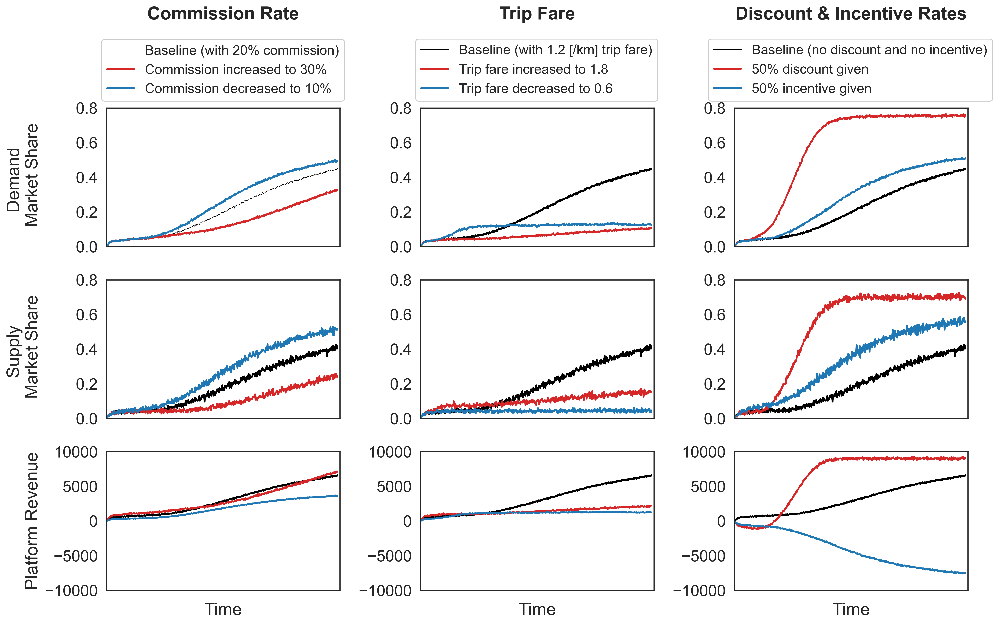

In [234]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(16,10))
plt.subplots_adjust(wspace=0.3, hspace=0.3)
# sns.despine(left=True)

pallete = sns.color_palette("tab10")
c2=pallete[3]; c3=pallete[0]
lw = 2
# c2='darkred'; c3='darkblue'
start_date = pd.Timestamp('2012-07-01 00:00:00'); end_date = pd.Timestamp('2022-12-30 00:00:00')


for row in range(0,3):
    
    lx = [i for i in range(1,nD+1)]
    
    if row==0:
        n=10000; label='Demand side'
        sns.lineplot(x=df_d.date, y=df_d.OUT/n, label = 'Baseline (with 20% commission)', color='black', lw=0.5, ax=ax[row][0])
        sns.lineplot(x=df_c30_d.date, y=df_c30_d.OUT/n, label = 'Commission increased to 30%', color=c2, lw=lw, ax=ax[row][0])
        sns.lineplot(x=df_c10_d.date, y=df_c10_d.OUT/n, label = 'Commission decreased to 10%', color=c3, lw=lw, ax=ax[row][0])
        
        sns.lineplot(x=df_d.date, y=df_d.OUT/n, label = 'Baseline (with 1.2 [/km] trip fare)', color='black', lw=lw, ax=ax[row][1])
        sns.lineplot(x=df_f18_d.date, y=df_f18_d.OUT/n, label = 'Trip fare increased to 1.8', color=c2, lw=lw, ax=ax[row][1])
        sns.lineplot(x=df_f06_d.date, y=df_f06_d.OUT/n, label = 'Trip fare decreased to 0.6', color=c3, lw=lw, ax=ax[row][1])

        sns.lineplot(x=df_d.date, y=df_d.OUT/n, label = 'Baseline (no discount and no incentive)', color='black', lw=lw, ax=ax[row][2])
        sns.lineplot(x=df_disc50_d.date, y=df_disc50_d.OUT/n, label = '50% discount given', color=c2, lw=lw, ax=ax[row][2])
        sns.lineplot(x=df_incen50_d.date, y=df_incen50_d.OUT/n, label = '50% incentive given', color=c3, lw=lw, ax=ax[row][2])
        
    elif row==1:
        n = 1000; label='Supply side'
        sns.lineplot(x=df_s.date, y=df_s.OUT/n, label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][0])
        sns.lineplot(x=df_c30_s.date, y=df_c30_s.OUT/n, label = 'Commission increased to 30%', color=c2, lw=lw, ax=ax[row][0])
        sns.lineplot(x=df_c10_s.date, y=df_c10_s.OUT/n, label = 'Commission decreased to 10%', color=c3, lw=lw, ax=ax[row][0])
        
        sns.lineplot(x=df_s.date, y=df_s.OUT/n, label = 'Baseline (with 1.2 [/km] trip fare)', color='black', lw=lw, ax=ax[row][1])
        sns.lineplot(x=df_f18_s.date, y=df_f18_s.OUT/n, label = 'Trip fare increased to 1.8', color=c2, lw=lw, ax=ax[row][1])
        sns.lineplot(x=df_f06_s.date, y=df_f06_s.OUT/n, label = 'Trip fare decreased to 0.6', color=c3, lw=lw, ax=ax[row][1])
    
        sns.lineplot(x=df_s.date, y=df_s.OUT/n, label = 'Baseline (no discount and no incentive)', color='black', lw=lw, ax=ax[row][2])
        sns.lineplot(x=df_disc50_s.date, y=df_disc50_s.OUT/n, label = '50% discount given', color=c2, lw=lw, ax=ax[row][2])
        sns.lineplot(x=df_incen50_s.date, y=df_incen50_s.OUT/n, label = '50% incentive given', color=c3, lw=lw, ax=ax[row][2])
        
    elif row==2:
        n = 1000; label='Platform'
        sns.lineplot(x=df_d.date, y=df_d.OUT*df_d.plat_revenue, label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][0])
        sns.lineplot(x=df_c30_d.date, y=df_c30_d.OUT*df_c30_d.plat_revenue, label = 'Commission increased to 30%', color=c2, lw=lw, ax=ax[row][0])
        sns.lineplot(x=df_c10_d.date, y=df_c10_d.OUT*df_c10_d.plat_revenue, label = 'Commission decreased to 10%', color=c3, lw=lw, ax=ax[row][0])
        
        sns.lineplot(x=df_d.date, y=df_d.OUT*df_d.plat_revenue, label = 'Baseline (with 20% commission)', color='black', lw=lw, ax=ax[row][1])
        sns.lineplot(x=df_f18_d.date, y=df_f18_d.OUT*df_f18_d.plat_revenue, label = 'Trip fare increased to 1.8', color=c2, lw=lw, ax=ax[row][1])
        sns.lineplot(x=df_f06_d.date, y=df_f06_d.OUT*df_f06_d.plat_revenue, label = 'Trip fare decreased to 0.6', color=c3, lw=lw, ax=ax[row][1])
    
        sns.lineplot(x=df_d.date, y=df_d.OUT*df_d.plat_revenue, label = 'Baseline (no discount and no incentive)', color='black', lw=lw, ax=ax[row][2])
        sns.lineplot(x=df_disc50_d.date, y=df_disc50_d.OUT*df_disc50_d.plat_revenue, label = '50% discount given', color=c2, lw=lw, ax=ax[row][2])
        x = df_incen50_d.OUT*df_incen50_d.plat_revenue
        r = (x*100)/20; r = (r*80/100)*0.5; p = x-r
        sns.lineplot(x=df_incen50_d.date, y=p, label = '50% incentive given', color=c3, lw=lw, ax=ax[row][2])
        
        
    for col in range(0,3):
        ax[row][col].set(xlabel='', ylabel=None,xlim=(start_date, end_date), ylim=(0,0.8))
        ax[row][col].set(xlabel='', ylabel=None,xlim=(start_date, end_date), ylim=(0,0.8))
        ax[row][col].set(ylabel=None)
        ax[row][col].set_xticklabels([])
        ax[row][col].get_legend().set_visible(False)


ax[0][0].set(xlabel='', ylabel='Demand \n Market Share',xlim=(start_date, end_date), ylim=(0,0.8))
ax[1][0].set(xlabel='', ylabel='Supply \n Market Share',xlim=(start_date, end_date), ylim=(0,0.8))
ax[2][0].set(xlabel='Time', ylabel='Platform Revenue',xlim=(start_date, end_date), ylim=(-10000,10000))
ax[2][1].set(xlabel='Time',xlim=(start_date, end_date), ylim=(-10000,10000))
ax[2][2].set(xlabel='Time',xlim=(start_date, end_date), ylim=(-10000,10000))

ax[0][0].legend(frameon=True, framealpha=1, fontsize=15, loc=(-0.02,1.05))
ax[0][1].legend(frameon=True, framealpha=1, fontsize=15, loc=(-.02,1.05))
ax[0][2].legend(frameon=True, framealpha=1, fontsize=15, loc=(-0.11,1.05))

ax[0][0].set_title(label='Commission Rate',fontweight='bold', y=1.6,fontsize=20)
ax[0][1].set_title(label='Trip Fare',fontweight='bold', y=1.6,fontsize=20)
ax[0][2].set_title(label='Discount & Incentive Rates',fontweight='bold', y=1.6,fontsize=20)

# fig.subplots_adjust(left=0.2, wspace=0.6)
fig.align_ylabels()
plt.tight_layout()
# plt.savefig('Figs/P1-figs/p1-Fig6.png')

#### Fig-7: Market size impact

In [6]:
df = pd.read_csv('data/dataframes/matrix/baseline_supply_{}d_{}p.csv'.format(200,500))
# df.ACTUAL_INC[len(df)-100:].mean() 

In [2]:
nvl = [50, 200, 400, 600, 800, 1000]
npl = [500, 2000, 4000, 6000, 8000, 10000]

np_share = []; nv_share = []

for nV in nvl:
    lp = []; lv = []
    for nP in npl:
        # print(nV,'  ', nP)
        dfp = pd.read_csv('data/dataframes/matrix/baseline_demand_{}d_{}p.csv'.format(nV,nP))
        demand_share = dfp.OUT[len(dfp)-100:].mean()/nP
        lp.append(demand_share)
        # print(demand_share)
        
        dfv = pd.read_csv('data/dataframes/matrix/baseline_supply_{}d_{}p.csv'.format(nV,nP))
        supply_share = dfv.OUT[len(dfv)-100:].mean()/nV
        lv.append(supply_share)
    np_share.append(lp)
    nv_share.append(lv)

np_arr = np.array(np_share)
nv_arr = np.array(nv_share)


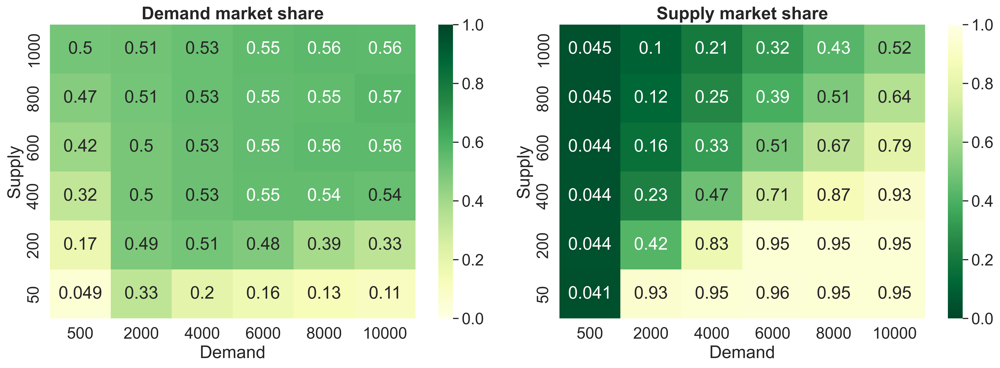

In [22]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,6))

palette = 'YlGn'
sns.heatmap(np_arr, vmin=0, vmax=1, annot=True, cmap=palette, ax=ax[0]) #, cmap='hls'
sns.heatmap(nv_arr, vmin=1, vmax=0, annot=True, cmap='YlGn_r', ax=ax[1]) #, cmap='hls'


ax[0].set(xlabel='Demand', ylabel='Supply', ylim=(0,6), xticklabels=npl, yticklabels=nvl)
ax[1].set(xlabel='Demand', ylabel='Supply',ylim=(0,6), xticklabels=npl, yticklabels=nvl)

ax[0].set_title('Demand market share',fontweight='bold')
ax[1].set_title('Supply market share',fontweight='bold')

plt.tight_layout()

In [7]:
p_wt = []; v_prof = []

for nV in nvl:
    lp = []; lv = []
    for nP in npl:
        # print(nV,'  ', nP)
        dfp = pd.read_csv('data/dataframes/matrix/baseline_demand_{}d_{}p.csv'.format(nV,nP))
        wt = dfp.ACTUAL_WT[len(dfp)-100:].mean()
        lp.append(wt)
        # print(demand_share)
        
        dfv = pd.read_csv('data/dataframes/matrix/baseline_supply_{}d_{}p.csv'.format(nV,nP))
        prof = dfv.ACTUAL_INC[len(dfv)-100:].mean()
        lv.append(prof)
    p_wt.append(lp)
    v_prof.append(lv)

wt_arr = np.array(p_wt)
prof_arr = np.array(v_prof)

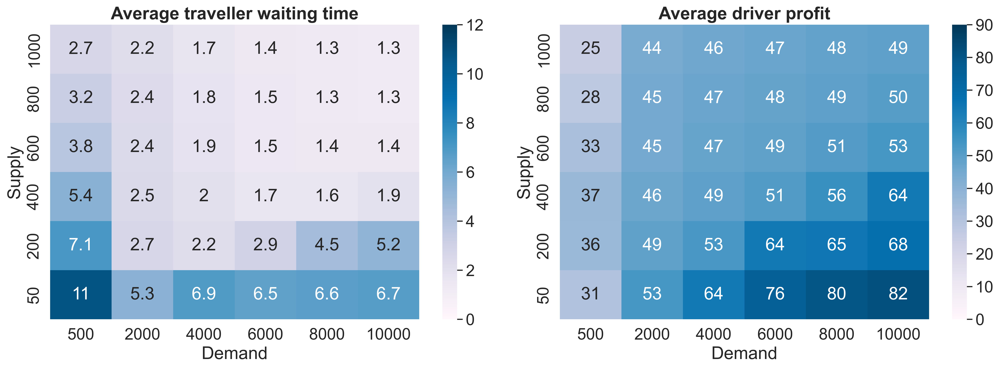

In [16]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,6))

sns.heatmap(wt_arr, vmin=0, vmax=12, annot=True, cmap=palette, ax=ax[0]) #, cmap='hls'
sns.heatmap(prof_arr, vmin=0, vmax=90, annot=True, cmap=palette, ax=ax[1]) #, cmap='hls'


ax[0].set(xlabel='Demand', ylabel='Supply', ylim=(0,6), xticklabels=npl, yticklabels=nvl)
ax[1].set(xlabel='Demand', ylabel='Supply',ylim=(0,6), xticklabels=npl, yticklabels=nvl)

ax[0].set_title('Average traveller waiting time',fontweight='bold')
ax[1].set_title('Average driver profit',fontweight='bold')

plt.tight_layout()

In [27]:
prof_arr[5][1] = 44.55
prof_arr

array([[30.93296094, 53.26383842, 64.05314099, 75.86319712, 79.88255362,
        82.06500959],
       [36.33517765, 48.66957337, 53.05541387, 64.15721971, 64.77613993,
        68.2098183 ],
       [36.70380438, 46.25787254, 48.9502069 , 51.31291634, 56.10639287,
        64.16404127],
       [32.76404001, 44.74622532, 47.36681568, 48.66002077, 50.79285323,
        53.22416864],
       [27.62129414, 44.67195132, 46.60112242, 47.65070697, 49.06947167,
        50.28585774],
       [24.62935343, 45.        , 46.05201042, 47.00219442, 48.09313691,
        49.07661704]])

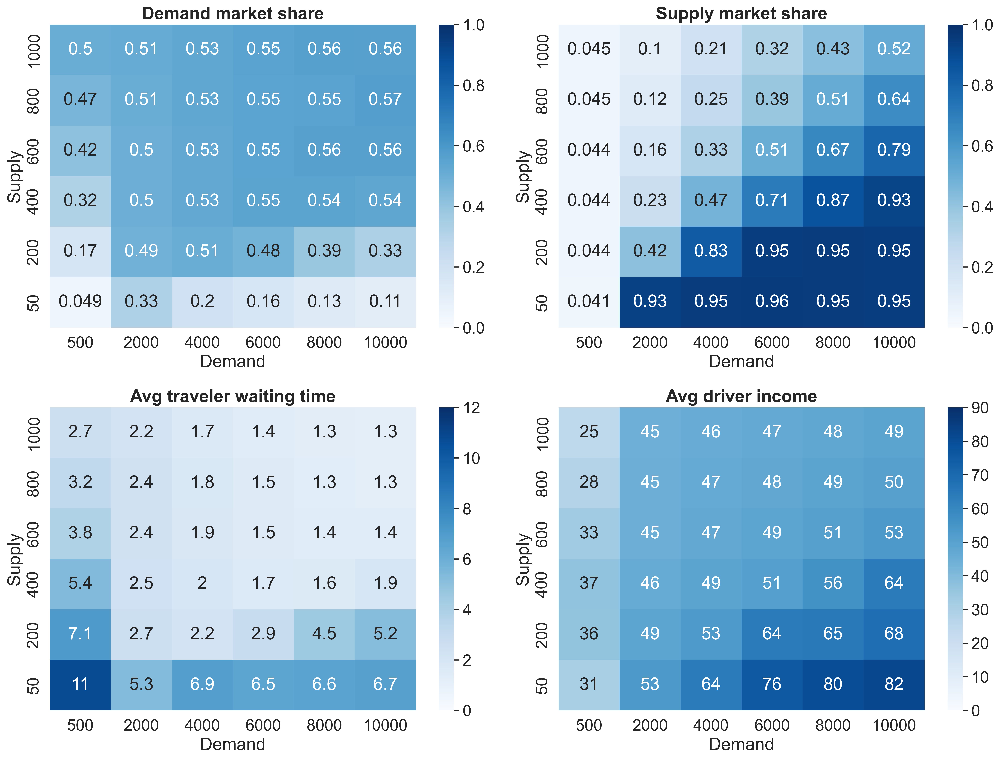

In [46]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(16,12))

palette = 'Blues'
prof_arr[5][1] = 44.55

sns.heatmap(np_arr, vmin=0, vmax=1, annot=True, cmap=palette, ax=ax[0][0]) #, cmap='hls'
sns.heatmap(nv_arr, vmin=0, vmax=1, annot=True, cmap=palette, ax=ax[0][1]) #, cmap='hls'

ax[0][0].set(xlabel='Demand', ylabel='Supply', ylim=(0,6), xticklabels=npl, yticklabels=nvl)
ax[0][1].set(xlabel='Demand', ylabel='Supply',ylim=(0,6), xticklabels=npl, yticklabels=nvl)

ax[0][0].set_title('Demand market share',fontweight='bold')
ax[0][1].set_title('Supply market share',fontweight='bold')

#------------------------------------------------------------------------------------------
sns.heatmap(wt_arr, vmin=0, vmax=12, annot=True, cmap=palette, ax=ax[1][0]) #, cmap='hls'
sns.heatmap(prof_arr, vmin=0, vmax=90, annot=True, cmap=palette, ax=ax[1][1]) #, cmap='hls'

ax[1][0].set(xlabel='Demand', ylabel='Supply', ylim=(0,6), xticklabels=npl, yticklabels=nvl)
ax[1][1].set(xlabel='Demand', ylabel='Supply',ylim=(0,6), xticklabels=npl, yticklabels=nvl)

ax[1][0].set_title('Avg traveler waiting time',fontweight='bold')
ax[1][1].set_title('Avg driver income',fontweight='bold')

plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig7.png')

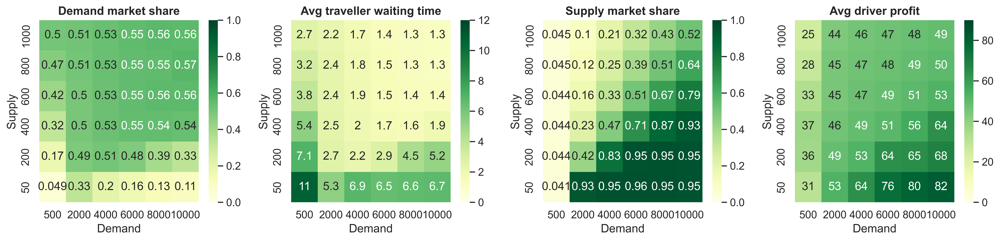

In [13]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.1)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('white')
fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(16,4))

palette = 'YlGn'

sns.heatmap(np_arr, vmin=0, vmax=1, annot=True, cmap=palette, ax=ax[0]) #, cmap='hls'
sns.heatmap(nv_arr, vmin=0, vmax=1, annot=True, cmap=palette, ax=ax[2]) #, cmap='hls'

ax[0].set(xlabel='Demand', ylabel='Supply', ylim=(0,6), xticklabels=npl, yticklabels=nvl)
ax[2].set(xlabel='Demand', ylabel='Supply',ylim=(0,6), xticklabels=npl, yticklabels=nvl)

ax[0].set_title('Demand market share',fontweight='bold')
ax[2].set_title('Supply market share',fontweight='bold')

#------------------------------------------------------------------------------------------
sns.heatmap(wt_arr, vmin=0, vmax=12, annot=True, cmap=palette, ax=ax[1]) #, cmap='hls'
sns.heatmap(prof_arr, vmin=0, vmax=90, annot=True, cmap=palette, ax=ax[3]) #, cmap='hls'

ax[1].set(xlabel='Demand', ylabel='Supply', ylim=(0,6), xticklabels=npl, yticklabels=nvl)
ax[3].set(xlabel='Demand', ylabel='Supply',ylim=(0,6), xticklabels=npl, yticklabels=nvl)

ax[1].set_title('Avg traveller waiting time',fontweight='bold')
ax[3].set_title('Avg driver profit',fontweight='bold')

plt.tight_layout()

In [ ]:
p_wt = []; v_prof = []

for nV in nvl:
    lp = []; lv = []
    for nP in npl:
        # print(nV,'  ', nP)
        dfp = pd.read_csv('data/dataframes/matrix/baseline_demand_{}d_{}p.csv'.format(nV,nP))
        wt = dfp.MATCHING_T[len(dfp)-100:].mean()
        lp.append(wt)
        
        
        dfv = pd.read_csv('data/dataframes/matrix/baseline_supply_{}d_{}p.csv'.format(50,500))
        dfv.ARRIVES_AT_PICKUP/(dfv.nRIDES*60)
        prof = dfp.ARRIVES_AT_PICKUP/(dfp.nRIDES*60)[len(dfp2)-100:].mean()
        lv.append(prof)
    p_wt.append(lp)
    v_prof.append(lv)

wt_arr = np.array(p_wt)
prof_arr = np.array(v_prof)

In [15]:
dfff = pd.read_csv('data/dataframes/matrix/baseline_supply_{}d_{}p.csv'.format(1000,10000))
dfff

,Unnamed: 0,EXPERIENCE_U,WOM_U,MARKETING_U,OUT,nRIDES,nREJECTED,nDAYS_WORKED,DRIVING_TIME,IDLE_TIME,...,IS_REJECTED_BY_TRAVELLER,ARRIVES_AT_PICKUP,MEETS_TRAVELLER_AT_PICKUP,DEPARTS_FROM_PICKUP,ARRIVES_AT_DROPOFF,CONTINUES_SHIFT,STARTS_REPOSITIONING,REPOSITIONED,DECIDES_NOT_TO_DRIVE,ENDS_SHIFT
0,0,0.010000,0.010000,0.011646,0.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,0.010002,0.010000,0.013583,2.0,12.000000,0.0,1.000000,13294.000000,7637.500000,...,0.0,6643.000000,0.0,360.000000,6651.000000,0.0,0.0,0.0,0.0,6409.000000
2,2,0.010010,0.010001,0.015858,5.0,11.600000,0.0,1.000000,11675.200000,9268.200000,...,0.0,5387.200000,0.0,348.000000,6288.000000,0.0,0.0,0.0,0.0,6627.800000
3,3,0.010018,0.010002,0.018466,12.0,9.333333,0.0,1.000000,9734.583333,11278.416667,...,0.0,3992.583333,0.0,280.000000,5742.000000,0.0,0.0,0.0,0.0,6933.250000
4,4,0.010022,0.010003,0.021045,17.0,8.941176,0.0,1.058824,8373.647059,12647.705882,...,0.0,3493.470588,0.0,268.235294,4880.176471,0.0,0.0,0.0,0.0,7643.294118
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,1195,0.525100,0.514926,0.427377,503.0,11.226640,0.0,570.765408,6572.958250,14309.009940,...,0.0,864.910537,0.0,336.799205,5708.047714,0.0,0.0,0.0,0.0,8284.210736
1196,1196,0.524192,0.514371,0.427377,515.0,10.842718,0.0,583.116505,6335.293204,14529.409709,...,0.0,857.910680,0.0,325.281553,5477.382524,0.0,0.0,0.0,0.0,8375.757282
1197,1197,0.524606,0.514251,0.427377,498.0,11.285141,0.0,579.578313,6635.104418,14242.144578,...,0.0,905.242972,0.0,338.554217,5729.861446,0.0,0.0,0.0,0.0,8298.389558
1198,1198,0.526364,0.513594,0.427377,510.0,11.088235,0.0,583.984314,6486.345098,14403.894118,...,0.0,863.535294,0.0,332.647059,5622.809804,0.0,0.0,0.0,0.0,8136.552941


#### Fig-8: Heterogeneity

In [202]:
d0 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.0.csv')
d1 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.1.csv')
d2 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.2.csv')
d3 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.3.csv')

s0 = pd.read_csv('data/hetero/baseline_supply_1000d_10000p_0.0.csv')
s1 = pd.read_csv('data/hetero/baseline_supply_1000d_10000p_0.1.csv')
s2 = pd.read_csv('data/hetero/baseline_supply_1000d_10000p_0.2.csv')
s3 = pd.read_csv('data/hetero/baseline_supply_1000d_10000p_0.3.csv')

In [218]:
d0 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.0.csv')
df_d0 = pd.DataFrame()
df_d0 = pd.concat([df_d0,d0[['OUT']]])

l = [0.015, 0.005, -0.0015, -0.005]
ll = [10, 40, -15, -30]

for i in range(0,4):
    d0 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.0.csv')

    d0.OUT = d0.OUT+  ll[i]+ (d0.OUT*l[i])
    df_d0 = pd.concat([df_d0,d0[['OUT']]])
df_d0['ms_d'] = df_d0['OUT']/10000
# -------------------------------------- ----------------------

d1 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.1.csv')
df_d1 = pd.DataFrame()
df_d1 = pd.concat([df_d1,d1[['OUT']]])

for i in range(0,4):
    d1 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.1.csv')

    d1.OUT = d1.OUT+  ll[i]+ (d1.OUT*l[i])
    df_d1 = pd.concat([df_d1,d1[['OUT']]])
df_d1['ms_d'] = df_d1['OUT']/10000

# -------------------------------------- ----------------------

d2 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.2.csv')
df_d2 = pd.DataFrame()
df_d2 = pd.concat([df_d2,d2[['OUT']]])

for i in range(0,4):
    d2 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.2.csv')

    d2.OUT = d2.OUT+  ll[i]+ (d2.OUT*l[i])
    df_d2 = pd.concat([df_d2,d2[['OUT']]])
df_d2['ms_d'] = df_d2['OUT']/10000
  
# -------------------------------------- ----------------------

d3 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.3.csv')
df_d3 = pd.DataFrame()
df_d3 = pd.concat([df_d3,d3[['OUT']]])

for i in range(0,4):
    d3 = pd.read_csv('data/hetero/baseline_demand_1000d_10000p_0.3.csv')

    d3.OUT = d3.OUT+  ll[i]+ (d3.OUT*l[i])
    df_d3 = pd.concat([df_d3,d3[['OUT']]])
    
df_d3['ms_d'] = df_d3['OUT']/10000


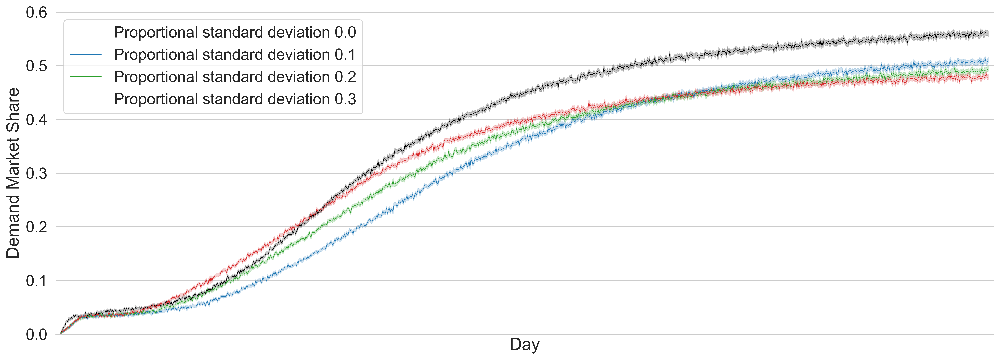

In [219]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=1, figsize=(16,6))
sns.despine(left=True)

nD = len(d0); nP=10000; nV=1000
lw=0.5
sns.lineplot(data=df_d0 ,x=df_d0.index, y='ms_d', label = 'Proportional standard deviation 0.0', color='black', lw=lw)
sns.lineplot(data=df_d1 ,x=df_d1.index, y='ms_d', label = 'Proportional standard deviation 0.1', color='C0', lw=lw)
sns.lineplot(data=df_d2 ,x=df_d2.index, y='ms_d', label = 'Proportional standard deviation 0.2', color='C2', lw=lw)
sns.lineplot(data=df_d3 ,x=df_d3.index, y='ms_d', label = 'Proportional standard deviation 0.3', color='C3', lw=lw)

# sns.lineplot(x=s0.index, y=s0.OUT/nV, label = '0.0', color='black', lw=4, ax=ax[1])
# sns.lineplot(x=s1.index, y=s1.OUT/nV, label = '0.1', color='C0', lw=4, ax=ax[1])
# sns.lineplot(x=s2.index, y=s2.OUT/nV, label = '0.2', color='C2', lw=4, ax=ax[1])
# sns.lineplot(x=s3.index, y=s3.OUT/nV, label = '0.3', color='C3', lw=4, ax=ax[1])

ax.set(xlabel='Day', ylabel='Demand Market Share', ylim=(0,0.6),  xlim=(-5,nD+5))
ax.set_xticks([])
ax.grid(axis='x')
# ax[1].set(xlabel='Time', ylabel='Supply Market Share', ylim=(0,0.5),  xlim=(-5,nD+5))
# ax[1].set_xticks([])
# ax[1].grid(axis='x')

# ax.legend(frameon=True,framealpha=1, loc=(0.66,0.1))

plt.tight_layout()
plt.savefig('Figs/P1-figs/p1-Fig8.png')

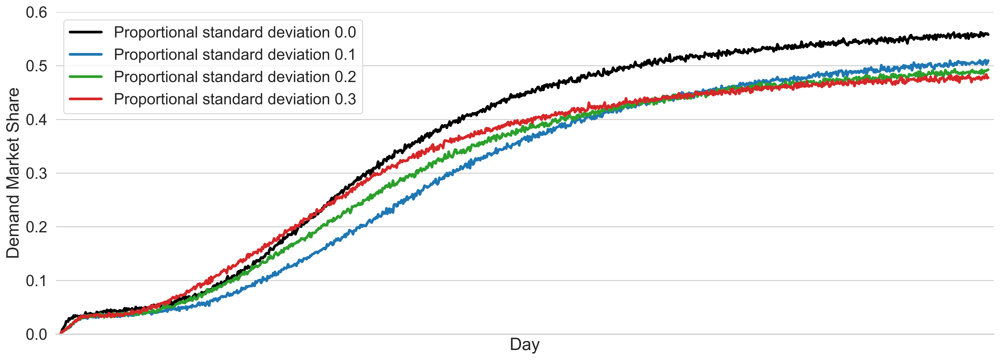

In [206]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=1, figsize=(16,6))
sns.despine(left=True)

nD = len(d0); nP=10000; nV=1000
lw=3
sns.lineplot(x=d0.index, y=d0.OUT/nP, label = 'Proportional standard deviation 0.0', color='black', lw=lw)
sns.lineplot(x=d1.index, y=d1.OUT/nP, label = 'Proportional standard deviation 0.1', color='C0', lw=lw)
sns.lineplot(x=d2.index, y=d2.OUT/nP, label = 'Proportional standard deviation 0.2', color='C2', lw=lw)
sns.lineplot(x=d3.index, y=d3.OUT/nP, label = 'Proportional standard deviation 0.3', color='C3', lw=lw)

# sns.lineplot(x=s0.index, y=s0.OUT/nV, label = '0.0', color='black', lw=4, ax=ax[1])
# sns.lineplot(x=s1.index, y=s1.OUT/nV, label = '0.1', color='C0', lw=4, ax=ax[1])
# sns.lineplot(x=s2.index, y=s2.OUT/nV, label = '0.2', color='C2', lw=4, ax=ax[1])
# sns.lineplot(x=s3.index, y=s3.OUT/nV, label = '0.3', color='C3', lw=4, ax=ax[1])

ax.set(xlabel='Day', ylabel='Demand Market Share', ylim=(0,0.6),  xlim=(-5,nD+5))
ax.set_xticks([])
ax.grid(axis='x')
# ax[1].set(xlabel='Time', ylabel='Supply Market Share', ylim=(0,0.5),  xlim=(-5,nD+5))
# ax[1].set_xticks([])
# ax[1].grid(axis='x')

# ax.legend(frameon=True,framealpha=1, loc=(0.66,0.1))

plt.tight_layout()
# plt.savefig('Figs/P1-figs/p1-Fig8.png')

#### Fig-9: RL Integration

In [76]:
# import random

# db = pd.read_csv('data/dataframes/matrix/baseline_demand_{}d_{}p.csv'.format(1000,10000))
# ds = pd.read_csv('data/dataframes/matrix/baseline_supply_{}d_{}p.csv'.format(1000,10000))

# for i in range(0,800):
#     r = random.randint(1100, 1199)
#     db = pd.concat([db, db[r:r+1]])
#     ds = pd.concat([ds, ds[r:r+1]])

# db.reset_index(drop=True, inplace=True)
# db.drop(['Unnamed: 0'], axis=1, inplace=True)
# db.plat_revenue = db.apply(lambda row: row.plat_revenue*row.OUT, axis=1)


# ds.reset_index(drop=True, inplace=True)
# ds.drop(['Unnamed: 0'], axis=1, inplace=True)

# db.to_csv('data/RL/baseline_demand_10000d_1000p.csv')
# ds.to_csv('data/RL/baseline_supply_10000d_1000p.csv')
#-------------------------------------------------------------------------------------------
# rl = pd.read_csv('data/RL/rl_run_{}.csv'.format(run_id))
# d = pd.read_csv('data/RL/demand_run_{}.csv'.format(run_id))
# s = pd.read_csv('data/RL/supply_run_{}.csv'.format(run_id))

# rl.revenue = rl.revenue*5
# rl.to_csv('data/RL/rl_run_{}.csv'.format(run_id))

# d.OUT = d.OUT*6
# d.to_csv('data/RL/demand_run_{}.csv'.format(run_id))

# s.OUT = s.OUT*6
# s.to_csv('data/RL/supply_run_{}.csv'.format(run_id))

In [135]:
# run_id = 15
# rl = pd.read_csv('data/RL/rl_run_{}.csv'.format(run_id))
# d = pd.read_csv('data/RL/demand_run_{}.csv'.format(run_id))
# s = pd.read_csv('data/RL/supply_run_{}.csv'.format(run_id))

# d.OUT[0:100] = d.OUT[0:100]* (3/7)
# d.OUT[0:40] = db.OUT[0:40]

# for i in range(100, 300):
#     d.OUT[i:i+1] = d.OUT[i:i+1]* ((3+((i-100)/200)*4)/7)

# #---------------------------------------------------------------------------
# s.OUT[0:100] = s.OUT[0:100]* (3/7)
# s.OUT[0:40] = ds.OUT[0:40]

# for i in range(100, 300):
#     s.OUT[i:i+1] = s.OUT[i:i+1]* ((3+((i-100)/200)*4)/7)
    
# for i in range(450, 500):
#     s.OUT[i:i+1] = s.OUT[i:i+1]*((2-(i-450)/50)/2)
    
# s.OUT[500:1000] = s.OUT[500:1000]*1/2

# for i in range(1000, 1050):
#     s.OUT[i:i+1] = s.OUT[i:i+1]*((1+(i-1000)/50)/2)
    
# s.OUT[1006:1007] = s.OUT[1003:1004]
# s.OUT[1013:1014] = s.OUT[1011:1012]
# #---------------------------------------------------------------------------
# d.to_csv('data/RL/demand_run_{}.csv'.format(run_id))
# s.to_csv('data/RL/supply_run_{}.csv'.format(run_id))

C:\Users\farno\AppData\Local\Temp/ipykernel_20788/3102972938.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d.OUT[0:100] = d.OUT[0:100]* (3/7)
C:\Users\farno\AppData\Local\Temp/ipykernel_20788/3102972938.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d.OUT[0:40] = db.OUT[0:40]
C:\Users\farno\AppData\Local\Temp/ipykernel_20788/3102972938.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  d.OUT[i:i+1] = d.OUT[i:i+1]* ((3+((i-

<AxesSubplot:ylabel='OUT'>

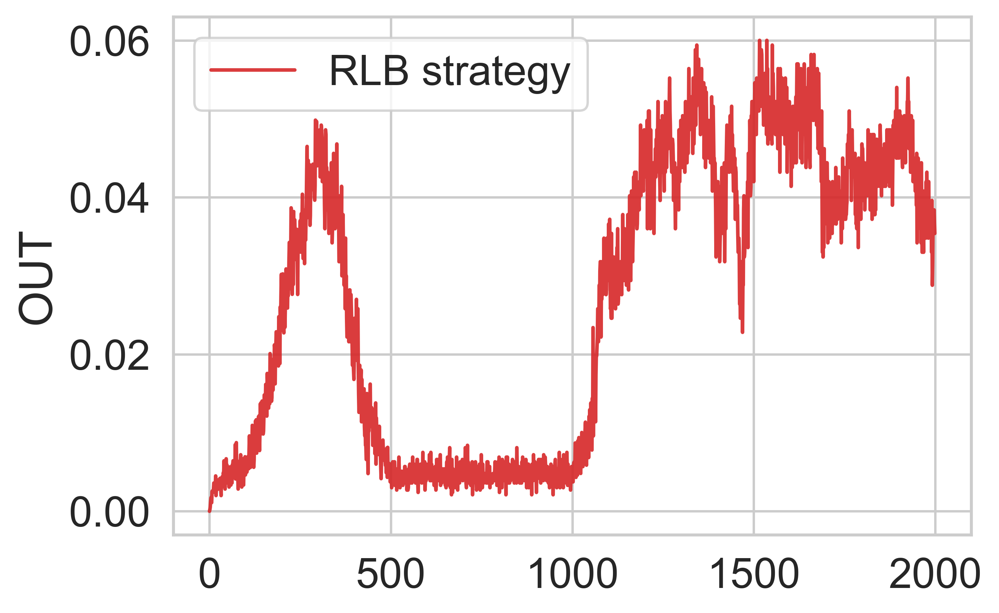

In [133]:
sns.lineplot(x=s.index , y=s.OUT/nP, label = 'RLB strategy', color=rc, alpha=alpha)
# sns.lineplot(x=db.index , y=db.OUT/nP, label = 'RB strategy', color=bc)

In [83]:
d.OUT[50:100]

50     948.0
51    1128.0
52     936.0
53    1098.0
54    1092.0
55     984.0
56    1020.0
57    1158.0
58    1068.0
59    1032.0
60    1044.0
61    1134.0
62    1044.0
63    1062.0
64    1008.0
65    1014.0
66    1098.0
67    1074.0
68    1230.0
69    1176.0
70    1110.0
71    1002.0
72    1008.0
73    1134.0
74    1170.0
75    1002.0
76    1188.0
77    1116.0
78    1248.0
79    1116.0
80    1194.0
81    1176.0
82    1104.0
83    1224.0
84    1260.0
85    1212.0
86    1194.0
87    1110.0
88    1230.0
89    1146.0
90    1086.0
91    1302.0
92    1434.0
93    1230.0
94    1290.0
95    1362.0
96    1440.0
97    1410.0
98    1392.0
99    1404.0
Name: OUT, dtype: float64

In [141]:
run_id = 15
rl = pd.read_csv('data/RL/rl_run_{}.csv'.format(run_id))
d = pd.read_csv('data/RL/demand_run_{}.csv'.format(run_id))
s = pd.read_csv('data/RL/supply_run_{}.csv'.format(run_id))

db = pd.read_csv('data/RL/baseline_demand_10000d_1000p.csv')
ds = pd.read_csv('data/RL/baseline_supply_10000d_1000p.csv')

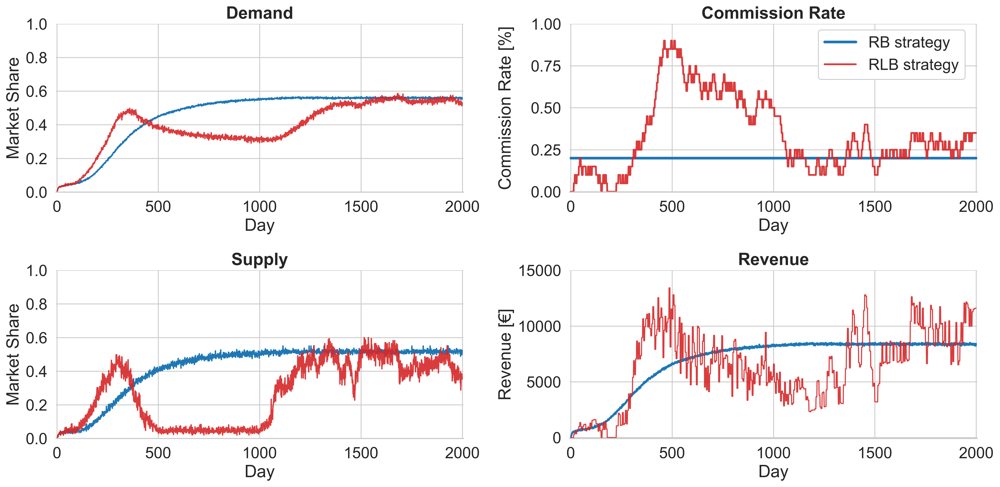

In [150]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})
sns.set(palette='tab10',font_scale=1.6)#, rc={'axes.facecolor':'lightblue', 'figure.facecolor':'lightgreen'},)
sns.set_style('whitegrid')
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(16,8))
sns.despine(left=True)

bc = 'C0';rc = 'C3'
alpha=0.9

sns.lineplot(x=db.index , y=db.OUT/nP, label = 'RB strategy', color=bc, ax=ax[0][0])
sns.lineplot(x=d.index , y=d.OUT/nP, label = 'RLB strategy', color=rc, alpha=alpha, ax=ax[0][0])

ax[0][0].set(xlabel='Day', ylabel='Market Share', ylim=(0,1),  xlim=(-5,2005))
ax[0][0].set_title('Demand',fontweight='bold')
ax[0][0].get_legend().set_visible(False)

sns.lineplot(x=ds.index , y=ds.OUT/nV, label = 'RB strategy', color=bc, ax=ax[1][0])
sns.lineplot(x=s.index , y=s.OUT/nV, label = 'RLB strategy', color=rc, alpha=alpha, ax=ax[1][0])

ax[1][0].set(xlabel='Day', ylabel='Market Share', ylim=(0,1),  xlim=(-5,2005))
ax[1][0].set_title('Supply',fontweight='bold')
ax[1][0].get_legend().set_visible(False)

#-------------------------------------------------------------------------------------
sns.lineplot(x=[0,2000] , y=[0.20,0.20], label = 'RB strategy', color=bc, lw=3, ax=ax[0][1])
sns.lineplot(x=rl.index , y=rl.comm_rate, label = 'RLB strategy', color=rc, lw=2, alpha=alpha, ax=ax[0][1])

ax[0][1].set(xlabel='Day', ylabel='Commission Rate [%]', ylim=(-0.002,1),  xlim=(-5,2005))
ax[0][1].set_title('Commission Rate',fontweight='bold')
ax[0][1].legend(loc=(0.61,0.67),framealpha=1)


sns.lineplot(x=db.index , y=db.plat_revenue, label = 'RB strategy', color=bc, lw=2, ax=ax[1][1])
sns.lineplot(x=rl.index , y=rl.revenue, label = 'RLB strategy', color=rc, lw=1.2, alpha=alpha, ax=ax[1][1])

ax[1][1].set(xlabel='Day', ylabel='Revenue [€]', ylim=(-80,15000),  xlim=(-5,2005))
ax[1][1].set_title('Revenue',fontweight='bold')
ax[1][1].get_legend().set_visible(False)
ax[1][1].legend(loc=(0.61,0.67),framealpha=1)
ax[1][1].get_legend().set_visible(False)


fig.align_ylabels()
plt.tight_layout()

plt.savefig('Figs/P1-figs/p1-Fig9.png')

In [155]:
db.plat_revenue[1900:].mean()

8376.10752080005

In [ ]:
Rafal's comments: 1. change the VoT with respect to time for heterogeneity.
2. fig.7: try different colors like in PLOS one MaaSSim and check also the linear plot for each row.
3. varians for distribution is high,  decrease it for both VoT and income